#### Objective of Analysis:

To examine how the trend or seasonality over the 6 paramaters, by the 7 separate regions.  This meaning that each of the 6 trend examinations are repeated area by area, to determine if weather differs and to what extent, area by area.
** With this analysis, the focus will only be on Max values.


Regions: 'NSW', 'NT', 'QL', 'SA', 'TA', 'VI', 'WA'


- [1. NSW Region](#NSW) 

- [2. NT Region](#NT) 

- [3. QL Region](#QL) 

- [4. SA Region](#SA) 

- [5. TA Region](#TA) 

- [6. VI Region](#VI) 

- [7. WA Region](#WA) 


In [1]:
# Import the necessary packages for analysis and visualization
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt, mpld3
%matplotlib inline
import json
import datetime

from shapely.geometry import Polygon, mapping
import geopandas as gpd
import folium
from folium.plugins import TimeSliderChoropleth
import seaborn as sns
import plotly.express as px

sns.set_style("whitegrid")

import warnings
warnings.filterwarnings("ignore")

In [2]:
# Load the dataset
weather = "C&P_Weather.csv"
print("Reading file: '{}'".format(weather))
weather_df = pd.read_csv(weather, parse_dates=[1])
print("Loaded...")
weather_df.head()

Reading file: 'C&P_Weather.csv'
Loaded...


,Date,Region,area,Precipitation_2nd_moment,Precipitation_max,Precipitation_mean,Precipitation_min,RelativeHumidity_2nd_moment,RelativeHumidity_max,RelativeHumidity_mean,...,SolarRadiation_mean,SolarRadiation_min,Temperature_2nd_moment,Temperature_max,Temperature_mean,Temperature_min,WindSpeed_2nd_moment,WindSpeed_max,WindSpeed_mean,WindSpeed_min
0,2005-01-01,NSW,8.002343e+05,0.028362,1.836935,0.044274,0.000000,253.559937,80.522964,36.355567,...,26.749389,14.515009,18.562212,35.878704,27.341182,14.485785,0.850048,7.670482,3.323550,1.354448
1,2005-01-01,NT,1.357561e+06,546.059262,315.266815,9.884958,0.000000,584.201131,95.683342,61.494675,...,19.781791,2.518120,12.920252,38.136787,29.881492,24.179960,1.930014,9.704402,5.296892,1.840394
2,2005-01-01,QL,1.730605e+06,35.641257,74.452164,1.453053,0.000000,403.134377,95.898270,47.959364,...,27.056979,6.033827,13.792599,37.047943,28.842866,20.951620,0.883048,7.675632,3.483753,1.106028
3,2005-01-01,SA,9.913151e+05,0.042837,3.193624,0.059078,0.000000,246.044713,81.980751,30.057683,...,27.142643,17.861103,34.799336,38.326847,30.793675,14.095855,1.655908,10.044715,4.657538,2.023657
4,2005-01-01,TA,6.778526e+04,12.068597,13.604791,3.099497,0.003973,111.754034,81.501442,65.086764,...,26.755711,20.742302,4.912013,16.228510,11.788805,6.686816,2.963118,11.432408,5.408138,1.995647


In [3]:
weather_df.columns

Index(['Date', 'Region', 'area', 'Precipitation_2nd_moment',
       'Precipitation_max', 'Precipitation_mean', 'Precipitation_min',
       'RelativeHumidity_2nd_moment', 'RelativeHumidity_max',
       'RelativeHumidity_mean', 'RelativeHumidity_min',
       'SoilWaterContent_2nd_moment', 'SoilWaterContent_max',
       'SoilWaterContent_mean', 'SoilWaterContent_min',
       'SolarRadiation_2nd_moment', 'SolarRadiation_max',
       'SolarRadiation_mean', 'SolarRadiation_min', 'Temperature_2nd_moment',
       'Temperature_max', 'Temperature_mean', 'Temperature_min',
       'WindSpeed_2nd_moment', 'WindSpeed_max', 'WindSpeed_mean',
       'WindSpeed_min'],
      dtype='object')

In [4]:
weather_df['Date'] = pd.to_datetime(weather_df['Date'], errors='coerce')

In [5]:
weather_df['Region'].unique()

array(['NSW', 'NT', 'QL', 'SA', 'TA', 'VI', 'WA'], dtype=object)

### NSW Region <a class="anchor" id="NSW"></a>

In [6]:
weather_NSW = weather_df.loc[(weather_df['Region'] == 'NSW')]
weather_NSW.shape

#df_new = Dataframe.loc[(Dataframe['goals_per_90_overall'] > .5)]

(5783, 27)

In [7]:
weather_NSW

,Date,Region,area,Precipitation_2nd_moment,Precipitation_max,Precipitation_mean,Precipitation_min,RelativeHumidity_2nd_moment,RelativeHumidity_max,RelativeHumidity_mean,...,SolarRadiation_mean,SolarRadiation_min,Temperature_2nd_moment,Temperature_max,Temperature_mean,Temperature_min,WindSpeed_2nd_moment,WindSpeed_max,WindSpeed_mean,WindSpeed_min
0,2005-01-01,NSW,800234.348986,0.028362,1.836935,0.044274,0.0,253.559937,80.522964,36.355567,...,26.749389,14.515009,18.562212,35.878704,27.341182,14.485785,0.850048,7.670482,3.323550,1.354448
7,2005-01-02,NSW,800234.348986,0.271386,6.854537,0.173879,0.0,224.769253,86.243828,38.699607,...,27.047523,15.775055,22.320857,33.976604,26.143898,12.067627,0.470928,7.448905,3.030897,0.864556
14,2005-01-03,NSW,800234.348986,10.308246,14.969810,3.011912,0.0,167.044018,88.527359,49.365152,...,24.197452,15.362626,16.619341,34.744976,27.408810,16.858456,2.002952,8.515941,3.958409,1.435490
21,2005-01-04,NSW,800234.348986,17.383363,22.842566,2.808620,0.0,267.158378,90.332771,57.095628,...,22.617291,7.576938,9.455474,28.945488,23.055527,12.495799,1.494301,7.364222,4.841764,1.401951
28,2005-01-05,NSW,800234.348986,0.273471,7.657155,0.157935,0.0,195.639724,88.623436,47.170735,...,28.076835,14.087289,13.352380,29.510120,22.425765,9.611800,1.043316,7.091141,4.014080,1.011328
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40446,2020-10-27,NSW,800234.348986,19.255058,58.436600,2.124025,0.0,305.295409,97.393547,65.191496,...,21.842008,8.514027,8.529138,22.218430,16.707067,7.288919,0.613602,5.497386,3.043550,1.036175
40453,2020-10-28,NSW,800234.348986,33.377184,30.506205,4.350241,0.0,363.242021,93.729408,65.642208,...,23.287059,9.952868,7.148141,22.422768,16.916040,8.654533,0.562205,4.353423,2.551310,0.790777
40460,2020-10-29,NSW,800234.348986,12.204651,16.275040,2.342508,0.0,326.339825,91.932632,59.019745,...,24.123445,15.170402,11.601502,24.129215,18.045304,9.860389,2.072462,7.925164,3.159553,0.663298
40467,2020-10-30,NSW,800234.348986,48.708134,46.937473,6.023114,0.0,272.160953,89.295311,65.992435,...,21.780309,8.277431,6.171237,24.310499,17.367429,10.133630,2.912816,8.527669,4.623190,1.465277


### PRECIPITATION Min & Max over Time - Year by Year 

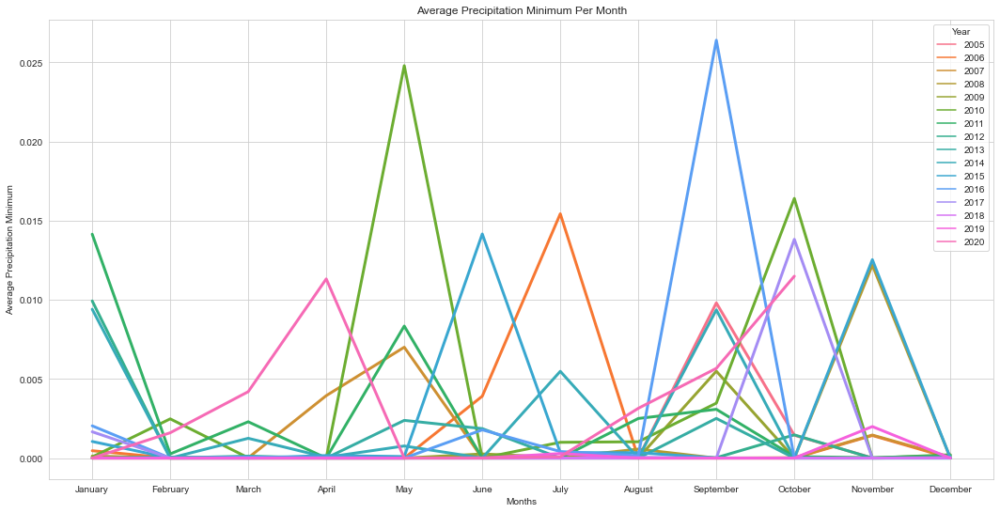

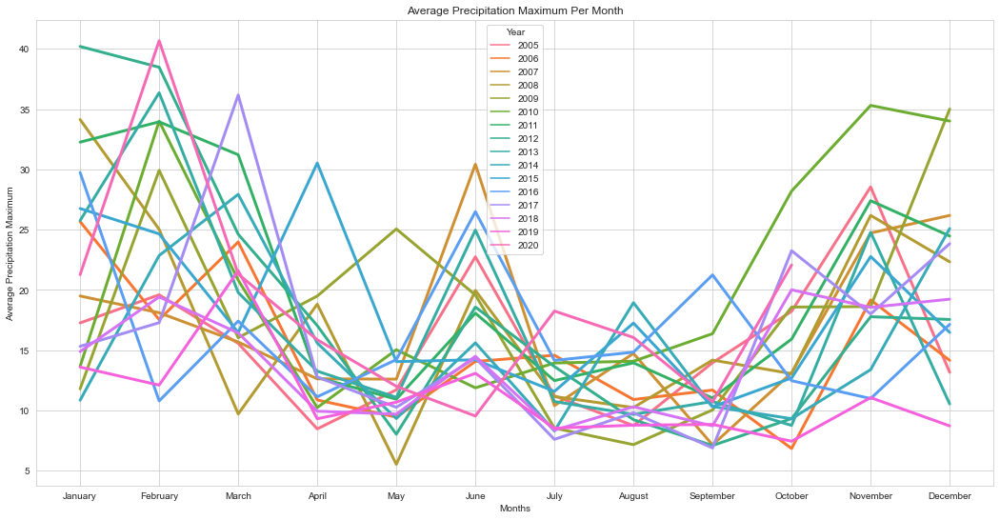

In [8]:
df_precipitation_NSW = weather_NSW[['Region', 'Date', 'Precipitation_min', 'Precipitation_max']].copy()
df_precipitation_NSW.drop_duplicates(inplace=True)
df_precipitation_NSW.sort_values(by=['Region', 'Date'])
df_precipitation_NSW.reset_index(drop=True, inplace=True)

df_precipitation_NSW['year'] = df_precipitation_NSW['Date'].dt.year
df_precipitation_NSW['month'] = df_precipitation_NSW['Date'].dt.month
df_precipitation_NSW['month_name'] = df_precipitation_NSW['Date'].dt.strftime('%B')

df_p = df_precipitation_NSW.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'Precipitation'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### RELATIVE HUMIDITY Min & Max over Time - Year by Year 

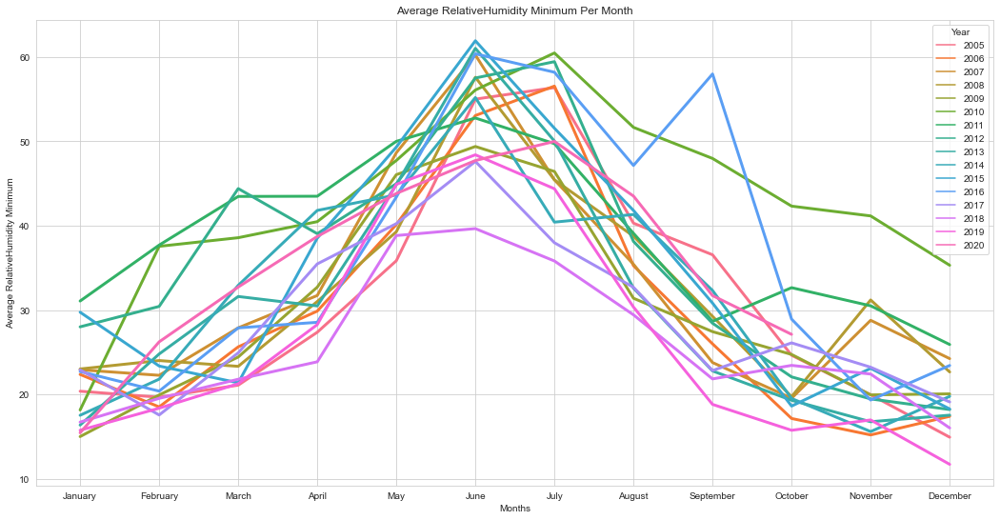

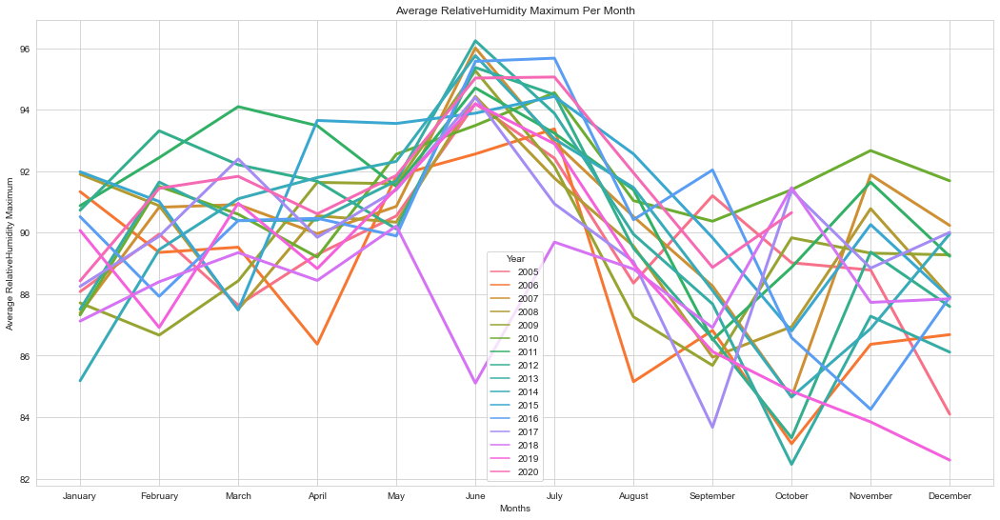

In [9]:
df_RelativeHumidity_NSW = weather_NSW[['Region', 'Date' , 'RelativeHumidity_min', 'RelativeHumidity_max']].copy()
df_RelativeHumidity_NSW.drop_duplicates(inplace=True)
df_RelativeHumidity_NSW.sort_values(by=['Region', 'Date'])
df_RelativeHumidity_NSW.reset_index(drop=True, inplace=True)

df_RelativeHumidity_NSW['year'] = df_RelativeHumidity_NSW['Date'].dt.year
df_RelativeHumidity_NSW['month'] = df_RelativeHumidity_NSW['Date'].dt.month
df_RelativeHumidity_NSW['month_name'] = df_RelativeHumidity_NSW['Date'].dt.strftime('%B')

df_p = df_RelativeHumidity_NSW.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'RelativeHumidity'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### SOIL WATER CONTENT Min & Max over Time - Year by Year 

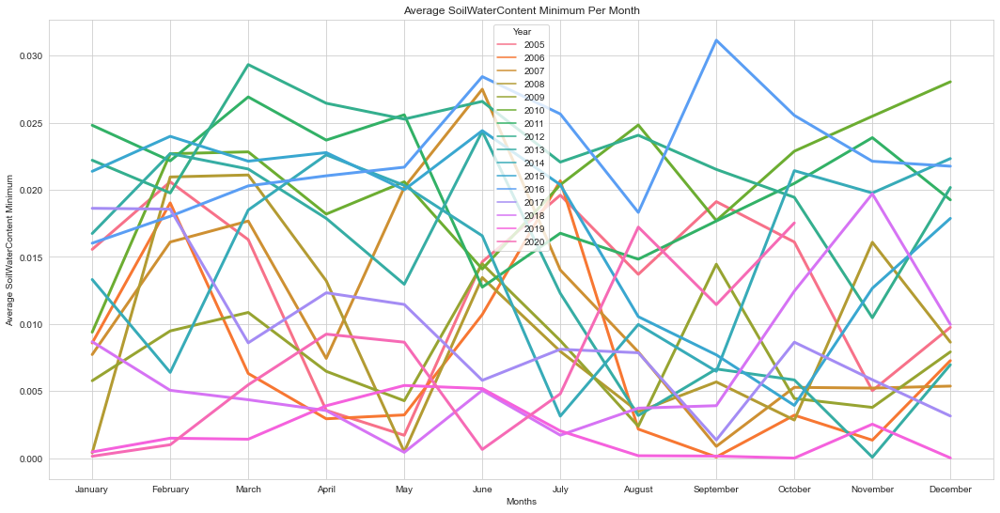

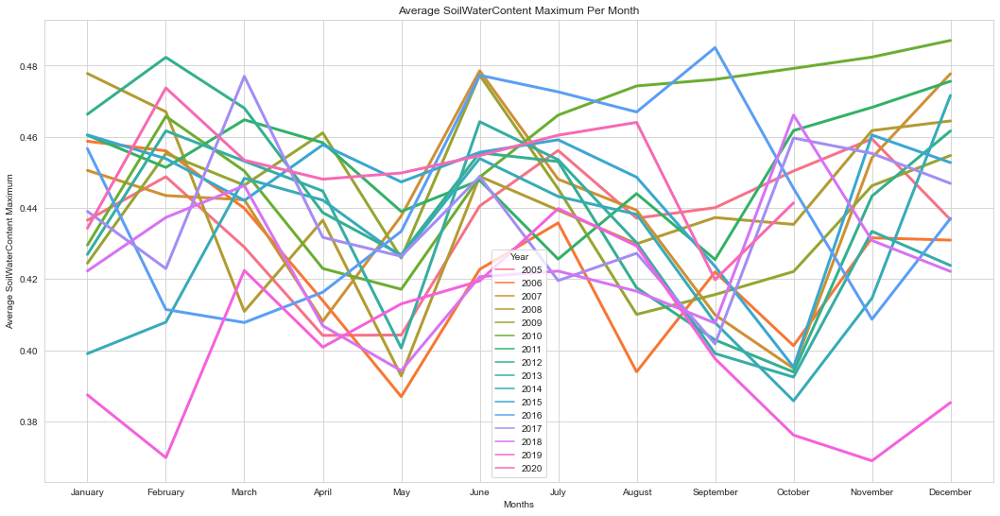

In [10]:
df_SoilWaterContent_NSW = weather_NSW[['Region', 'Date' ,'SoilWaterContent_min', 'SoilWaterContent_max']].copy()
df_SoilWaterContent_NSW.drop_duplicates(inplace=True)
df_SoilWaterContent_NSW.sort_values(by=['Region', 'Date'])
df_SoilWaterContent_NSW.reset_index(drop=True, inplace=True)

df_SoilWaterContent_NSW['year'] = df_SoilWaterContent_NSW['Date'].dt.year
df_SoilWaterContent_NSW['month'] = df_SoilWaterContent_NSW['Date'].dt.month
df_SoilWaterContent_NSW['month_name'] = df_SoilWaterContent_NSW['Date'].dt.strftime('%B')

df_p = df_SoilWaterContent_NSW.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'SoilWaterContent'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### SOLAR RADIATION Min & Max over Time - Year by Year

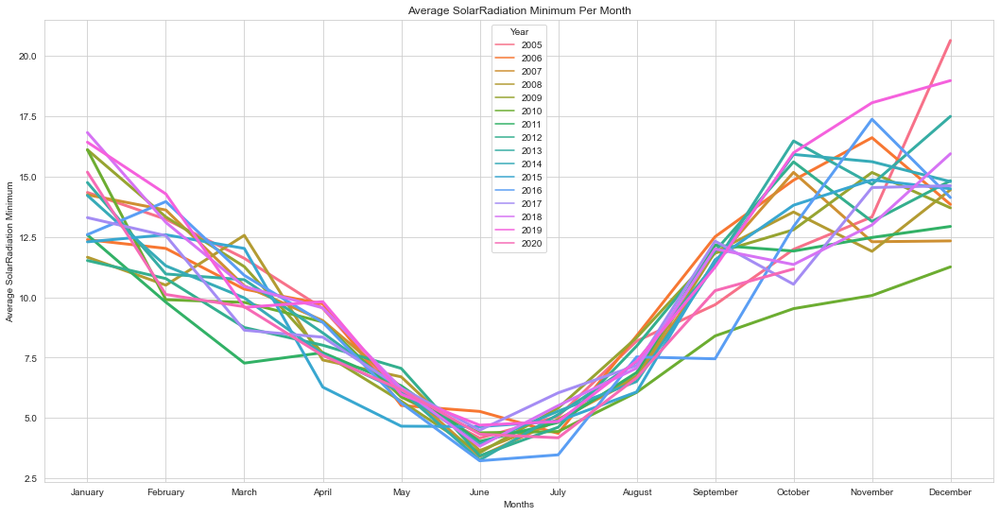

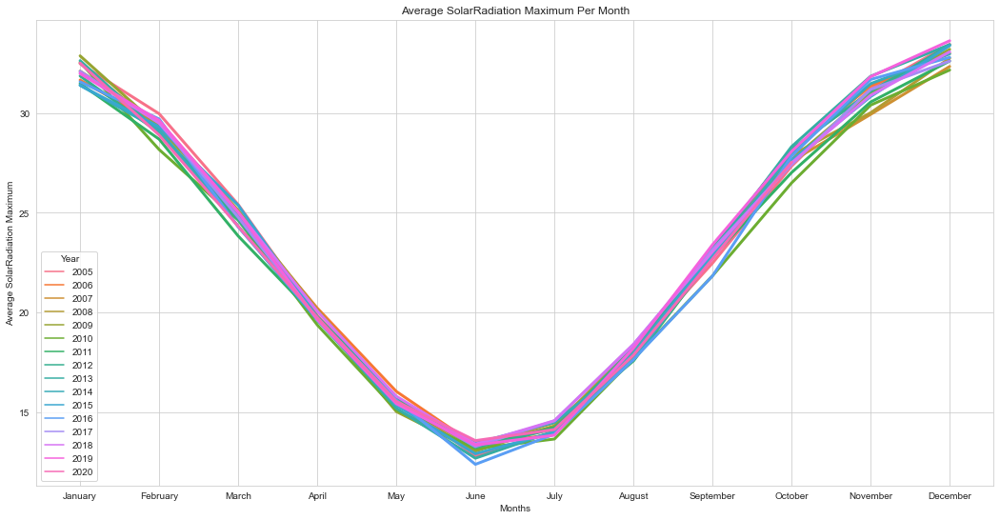

In [11]:
df_SolarRadiation_NSW = weather_NSW[['Region', 'Date' , 'SolarRadiation_min', 'SolarRadiation_max']].copy()
df_SolarRadiation_NSW.drop_duplicates(inplace=True)
df_SolarRadiation_NSW.sort_values(by=['Region', 'Date'])
df_SolarRadiation_NSW.reset_index(drop=True, inplace=True)

df_SolarRadiation_NSW['year'] = df_SolarRadiation_NSW['Date'].dt.year
df_SolarRadiation_NSW['month'] = df_SolarRadiation_NSW['Date'].dt.month
df_SolarRadiation_NSW['month_name'] = df_SolarRadiation_NSW['Date'].dt.strftime('%B')

df_p = df_SolarRadiation_NSW.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'SolarRadiation'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### TEMPERATURE Min & Max over Time - Year by Year 

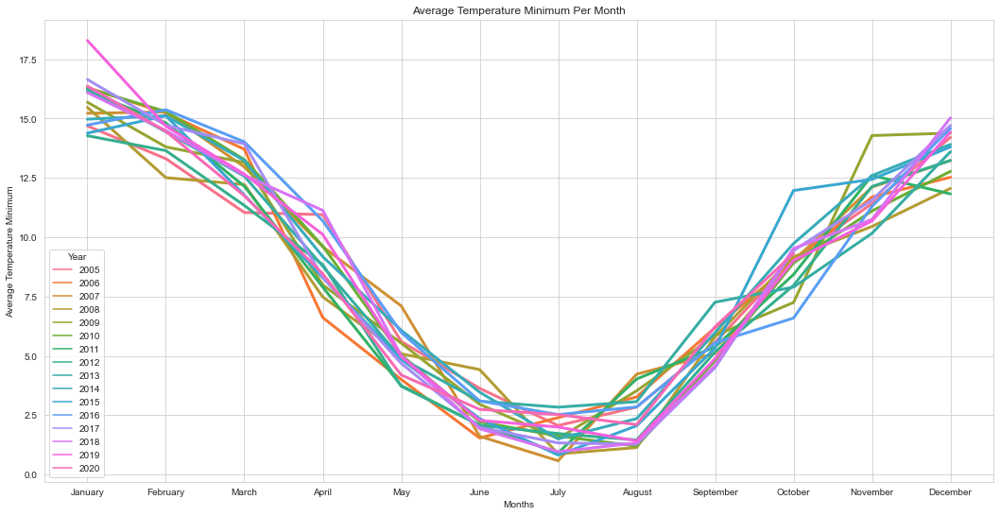

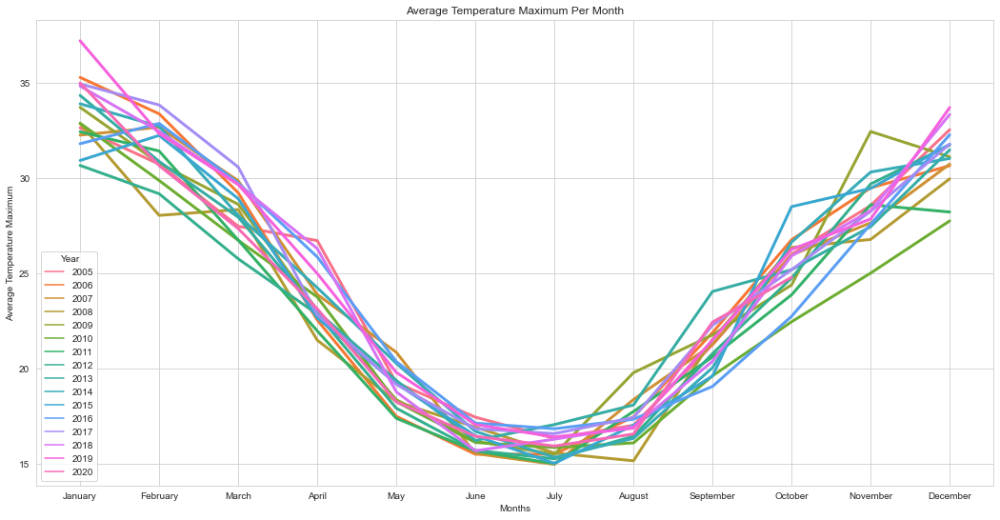

In [12]:
df_Temperature_NSW = weather_NSW[['Region', 'Date' ,'Temperature_min', 'Temperature_max']].copy()
df_Temperature_NSW.drop_duplicates(inplace=True)
df_Temperature_NSW.sort_values(by=['Region', 'Date'])
df_Temperature_NSW.reset_index(drop=True, inplace=True)

df_Temperature_NSW['year'] = df_Temperature_NSW['Date'].dt.year
df_Temperature_NSW['month'] = df_Temperature_NSW['Date'].dt.month
df_Temperature_NSW['month_name'] = df_Temperature_NSW['Date'].dt.strftime('%B')

df_p = df_Temperature_NSW.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'Temperature'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### WINDSPEED Min & Max over Time - Year by Year 

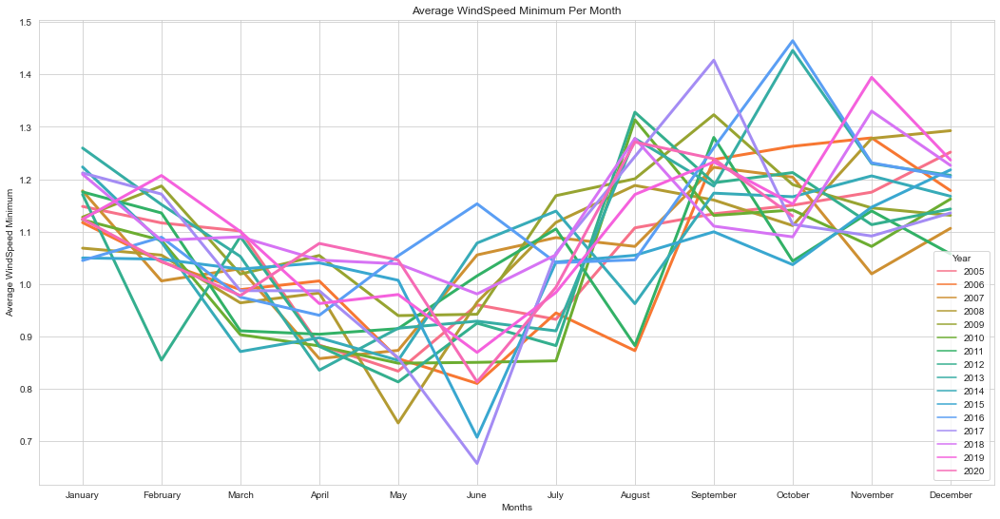

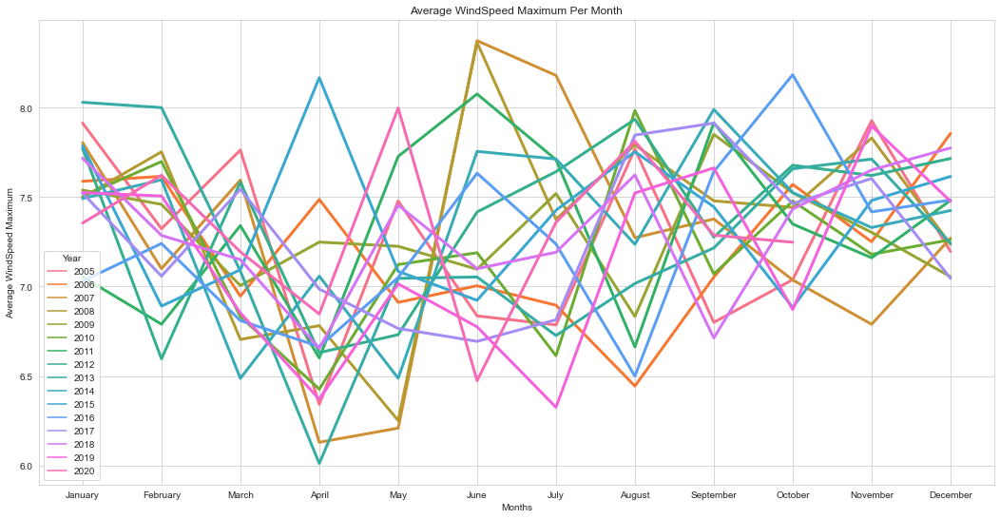

In [13]:
df_WindSpeed_NSW = weather_NSW[['Region', 'Date' ,'WindSpeed_min', 'WindSpeed_max']].copy()
df_WindSpeed_NSW.drop_duplicates(inplace=True)
df_WindSpeed_NSW.sort_values(by=['Region', 'Date'])
df_WindSpeed_NSW.reset_index(drop=True, inplace=True)

df_WindSpeed_NSW['year'] = df_WindSpeed_NSW['Date'].dt.year
df_WindSpeed_NSW['month'] = df_WindSpeed_NSW['Date'].dt.month
df_WindSpeed_NSW['month_name'] = df_WindSpeed_NSW['Date'].dt.strftime('%B')

df_p = df_WindSpeed_NSW.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'WindSpeed'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### NT Region <a class="anchor" id="NT"></a>

In [14]:
weather_NT = weather_df.loc[weather_df['Region'] == 'NT']
weather_NT.shape

(5783, 27)

### PRECIPITATION Min & Max over Time - Year by Year 

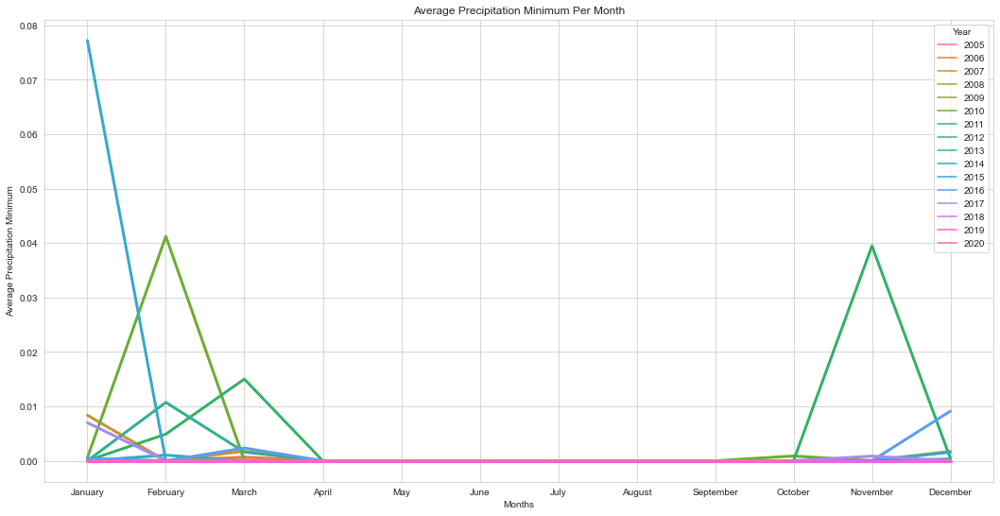

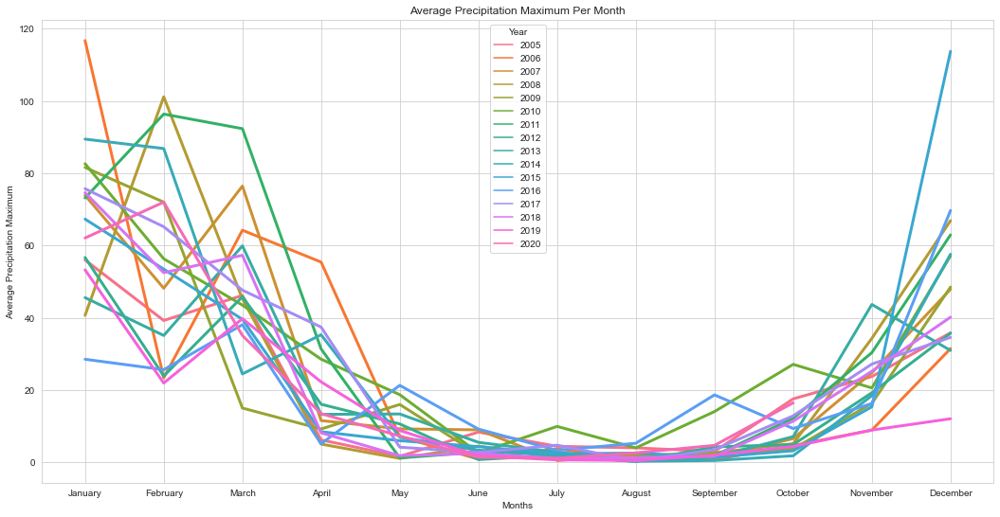

In [15]:
df_precipitation_NT = weather_NT[['Region', 'Date' , 'Precipitation_min', 'Precipitation_max']].copy()
df_precipitation_NT.drop_duplicates(inplace=True)
df_precipitation_NT.sort_values(by=['Region', 'Date'])
df_precipitation_NT.reset_index(drop=True, inplace=True)

df_precipitation_NT['year'] = df_precipitation_NT['Date'].dt.year
df_precipitation_NT['month'] = df_precipitation_NT['Date'].dt.month
df_precipitation_NT['month_name'] = df_precipitation_NT['Date'].dt.strftime('%B')

df_p = df_precipitation_NT.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'Precipitation'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### RELATIVE HUMIDITY Min & Max over Time - Year by Year 

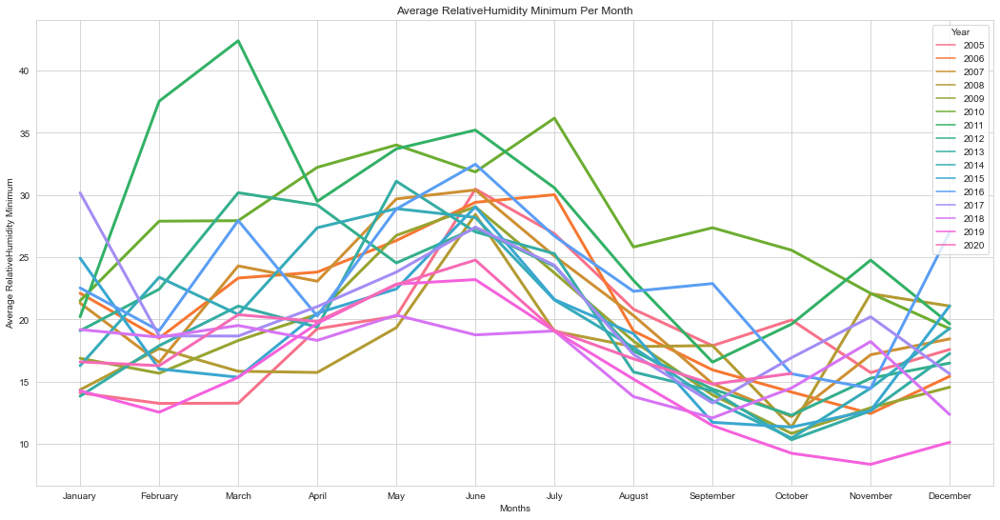

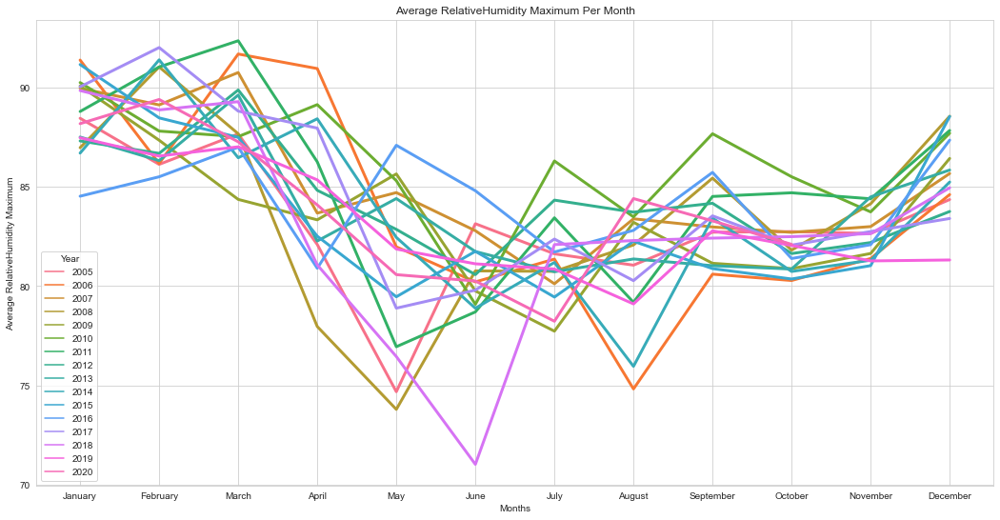

In [16]:
df_RelativeHumidity_NT = weather_NT[['Region', 'Date' , 'RelativeHumidity_min', 'RelativeHumidity_max']].copy()
df_RelativeHumidity_NT.drop_duplicates(inplace=True)
df_RelativeHumidity_NT.sort_values(by=['Region', 'Date'])
df_RelativeHumidity_NT.reset_index(drop=True, inplace=True)

df_RelativeHumidity_NT['year'] = df_RelativeHumidity_NT['Date'].dt.year
df_RelativeHumidity_NT['month'] = df_RelativeHumidity_NT['Date'].dt.month
df_RelativeHumidity_NT['month_name'] = df_RelativeHumidity_NT['Date'].dt.strftime('%B')

df_p = df_RelativeHumidity_NT.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'RelativeHumidity'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### SOIL WATER CONTENT Min & Max over Time - Year by Year 

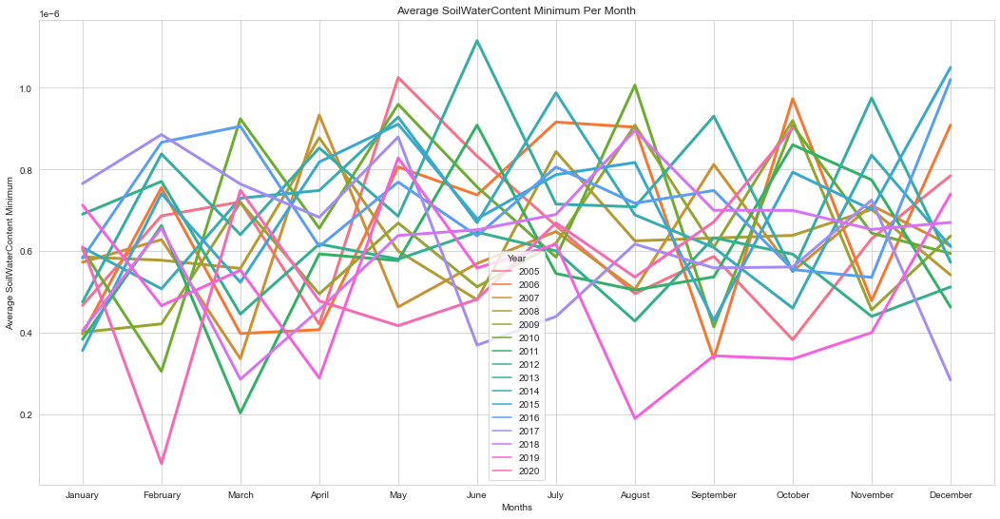

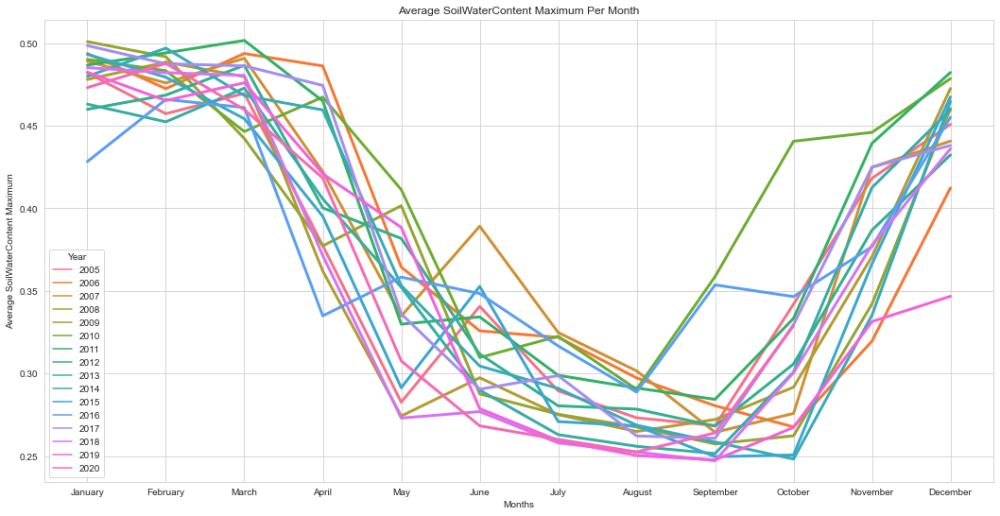

In [17]:
df_SoilWaterContent_NT = weather_NT[['Region', 'Date' , 'SoilWaterContent_min', 'SoilWaterContent_max']].copy()
df_SoilWaterContent_NT.drop_duplicates(inplace=True)
df_SoilWaterContent_NT.sort_values(by=['Region', 'Date'])
df_SoilWaterContent_NT.reset_index(drop=True, inplace=True)

df_SoilWaterContent_NT['year'] = df_SoilWaterContent_NT['Date'].dt.year
df_SoilWaterContent_NT['month'] = df_SoilWaterContent_NT['Date'].dt.month
df_SoilWaterContent_NT['month_name'] = df_SoilWaterContent_NT['Date'].dt.strftime('%B')

df_p = df_SoilWaterContent_NT.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'SoilWaterContent'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### SOLAR RADIATION Min & Max over Time - Year by Year

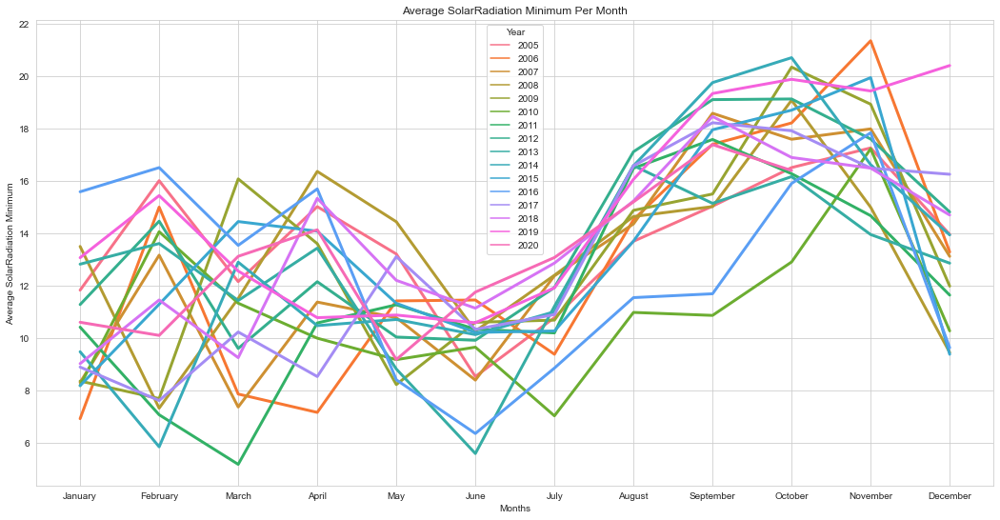

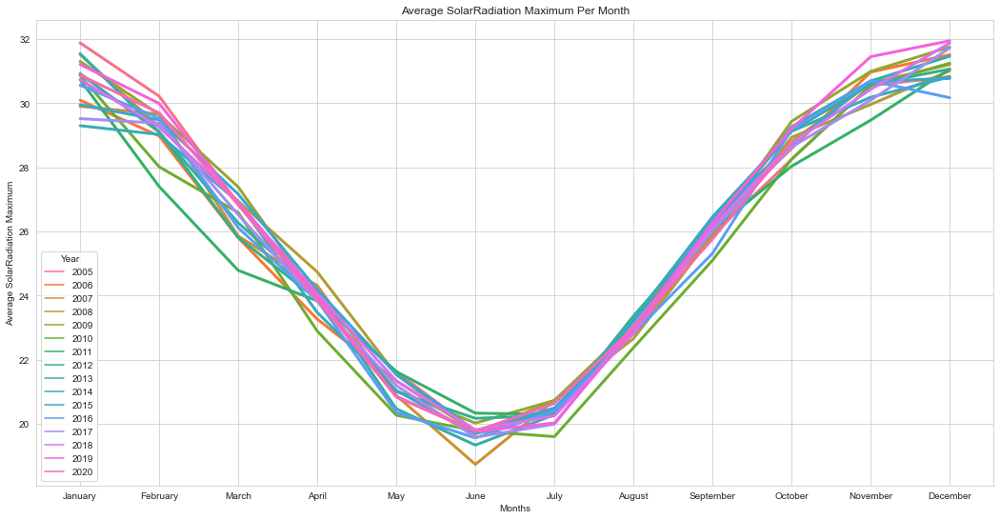

In [18]:
df_SolarRadiation_NT = weather_NT[['Region', 'Date' ,'SolarRadiation_min', 'SolarRadiation_max']].copy()
df_SolarRadiation_NT.drop_duplicates(inplace=True)
df_SolarRadiation_NT.sort_values(by=['Region', 'Date'])
df_SolarRadiation_NT.reset_index(drop=True, inplace=True)

df_SolarRadiation_NT['year'] = df_SolarRadiation_NT['Date'].dt.year
df_SolarRadiation_NT['month'] = df_SolarRadiation_NT['Date'].dt.month
df_SolarRadiation_NT['month_name'] = df_SolarRadiation_NT['Date'].dt.strftime('%B')

df_p = df_SolarRadiation_NT.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'SolarRadiation'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### TEMPERATURE Min & Max over Time - Year by Year 

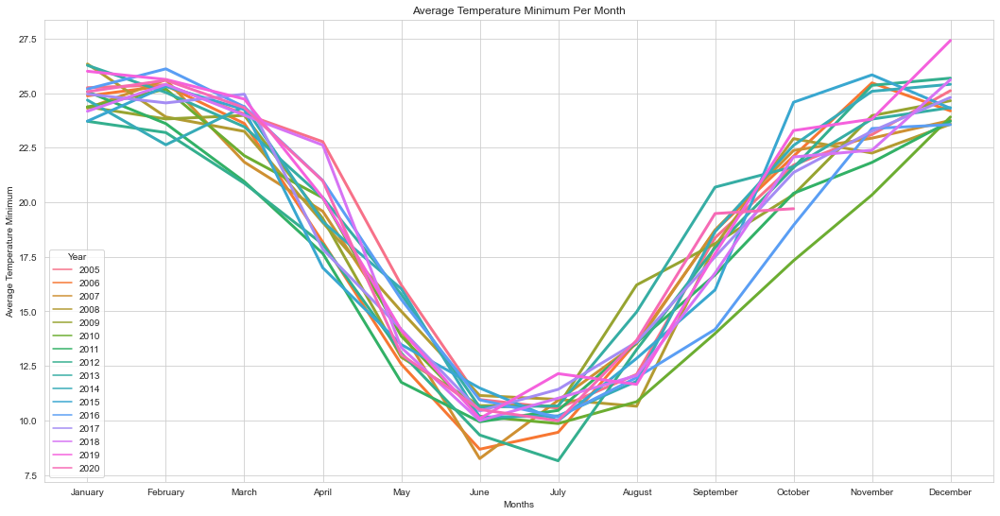

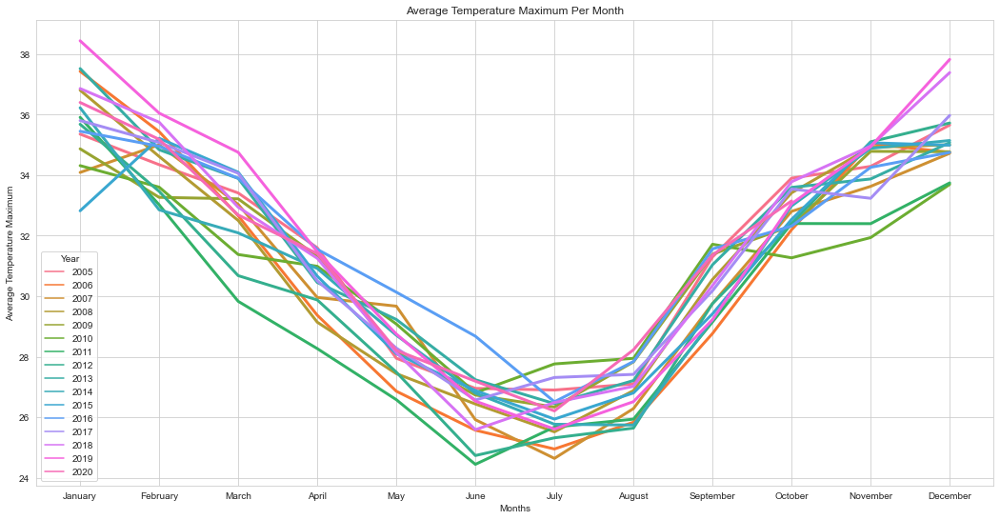

In [19]:
df_Temperature_NT = weather_NT[['Region', 'Date' , 'Temperature_min', 'Temperature_max']].copy()
df_Temperature_NT.drop_duplicates(inplace=True)
df_Temperature_NT.sort_values(by=['Region', 'Date'])
df_Temperature_NT.reset_index(drop=True, inplace=True)

df_Temperature_NT['year'] = df_Temperature_NT['Date'].dt.year
df_Temperature_NT['month'] = df_Temperature_NT['Date'].dt.month
df_Temperature_NT['month_name'] = df_Temperature_NT['Date'].dt.strftime('%B')

df_p = df_Temperature_NT.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'Temperature'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### WINDSPEED Min & Max over Time - Year by Year 

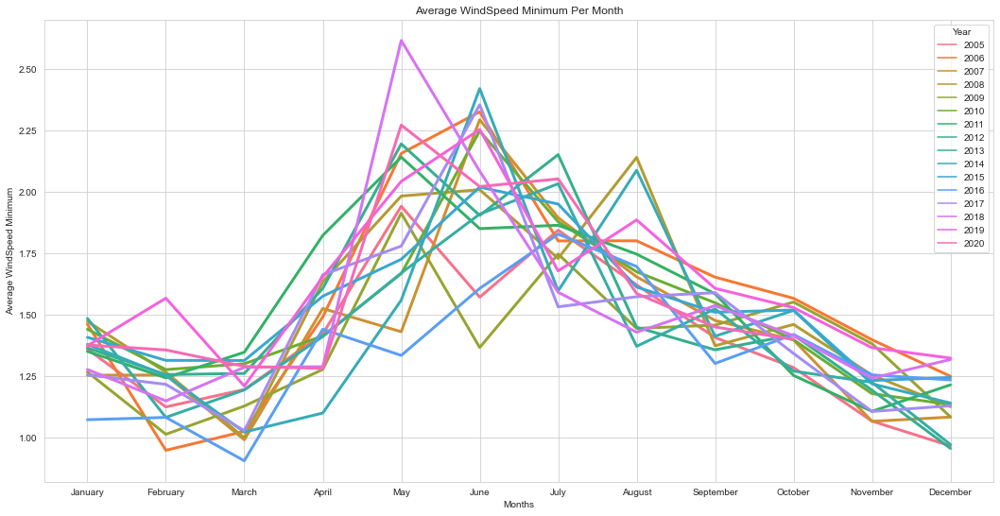

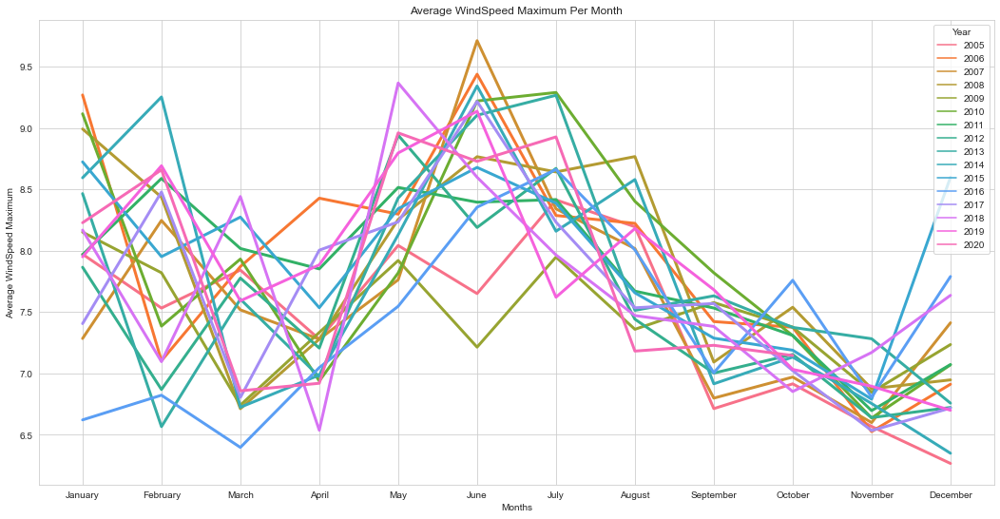

In [20]:
df_WindSpeed_NT = weather_NT[['Region', 'Date' ,'WindSpeed_min', 'WindSpeed_max']].copy()
df_WindSpeed_NT.drop_duplicates(inplace=True)
df_WindSpeed_NT.sort_values(by=['Region', 'Date'])
df_WindSpeed_NT.reset_index(drop=True, inplace=True)

df_WindSpeed_NT['year'] = df_WindSpeed_NT['Date'].dt.year
df_WindSpeed_NT['month'] = df_WindSpeed_NT['Date'].dt.month
df_WindSpeed_NT['month_name'] = df_WindSpeed_NT['Date'].dt.strftime('%B')

df_p = df_WindSpeed_NT.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'WindSpeed'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### QL Region <a class="anchor" id="QL"></a>

In [21]:
weather_QL = weather_df.loc[weather_df['Region'] == 'QL']
weather_QL.shape

(5783, 27)

### PRECIPITATION Min & Max over Time - Year by Year 

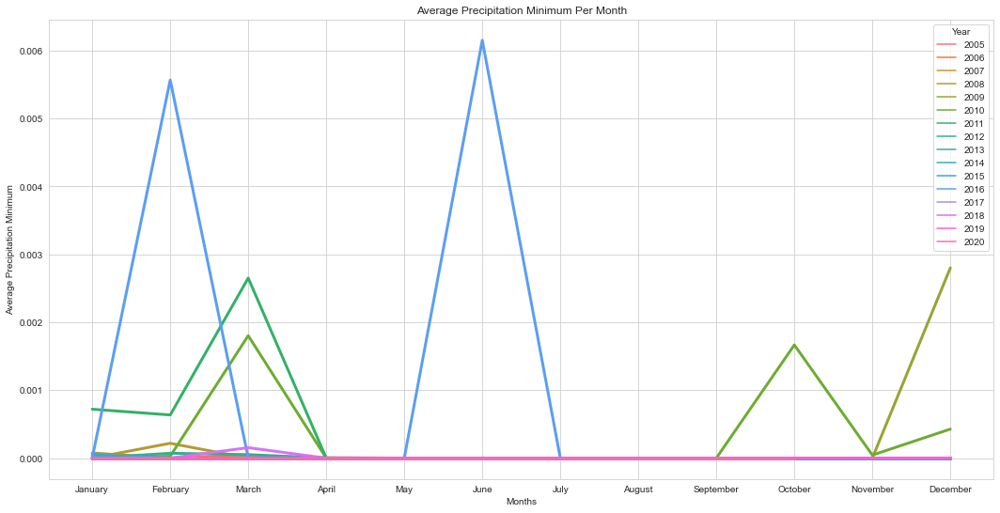

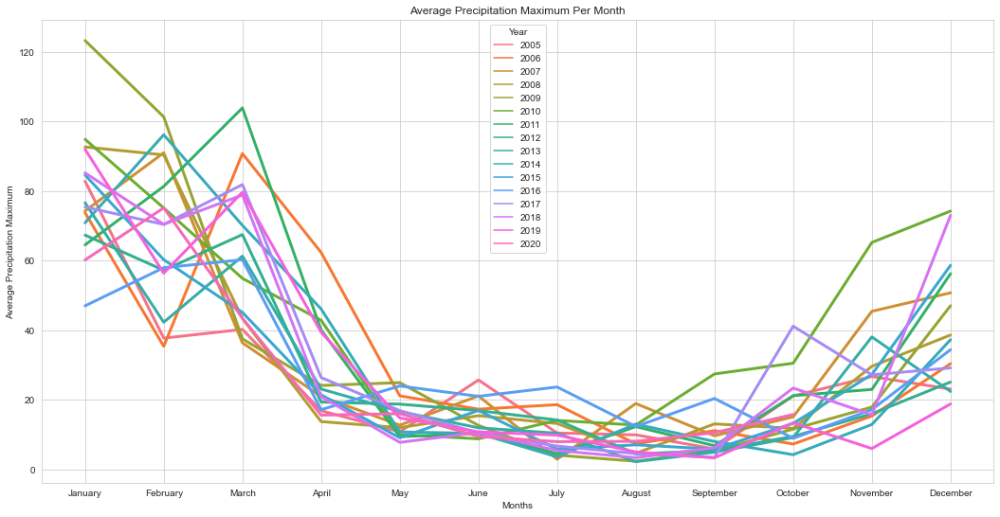

In [22]:
df_precipitation_QL = weather_QL[['Region', 'Date' ,'Precipitation_min', 'Precipitation_max']].copy()
df_precipitation_QL.drop_duplicates(inplace=True)
df_precipitation_QL.sort_values(by=['Region', 'Date'])
df_precipitation_QL.reset_index(drop=True, inplace=True)

df_precipitation_QL['year'] = df_precipitation_QL['Date'].dt.year
df_precipitation_QL['month'] = df_precipitation_QL['Date'].dt.month
df_precipitation_QL['month_name'] = df_precipitation_QL['Date'].dt.strftime('%B')

df_p = df_precipitation_QL.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'Precipitation'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### RELATIVE HUMIDITY Min & Max over Time - Year by Year 

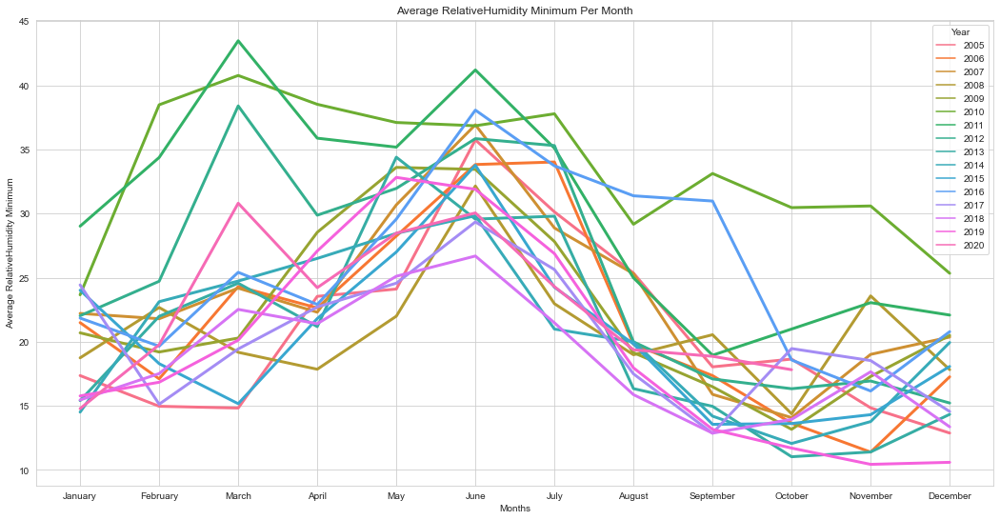

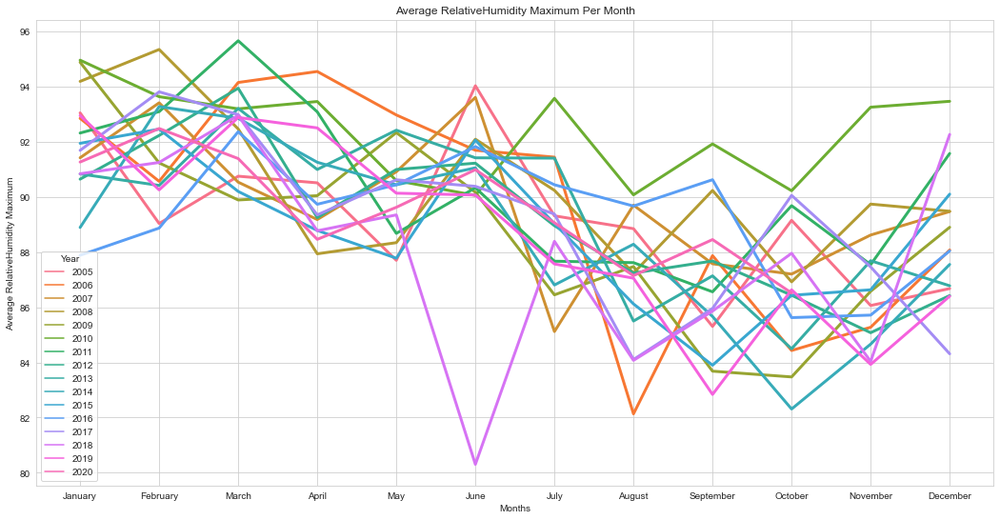

In [23]:
df_RelativeHumidity_QL = weather_QL[['Region', 'Date' ,'RelativeHumidity_min', 'RelativeHumidity_max']].copy()
df_RelativeHumidity_QL.drop_duplicates(inplace=True)
df_RelativeHumidity_QL.sort_values(by=['Region', 'Date'])
df_RelativeHumidity_QL.reset_index(drop=True, inplace=True)

df_RelativeHumidity_QL['year'] = df_RelativeHumidity_QL['Date'].dt.year
df_RelativeHumidity_QL['month'] = df_RelativeHumidity_QL['Date'].dt.month
df_RelativeHumidity_QL['month_name'] = df_RelativeHumidity_QL['Date'].dt.strftime('%B')

df_p = df_RelativeHumidity_QL.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'RelativeHumidity'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### SOIL WATER CONTENT Min & Max over Time - Year by Year 

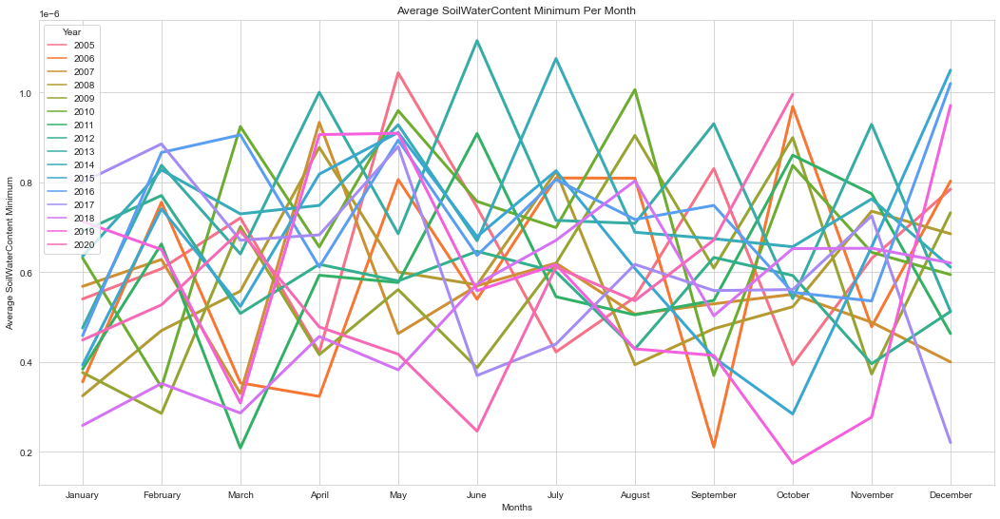

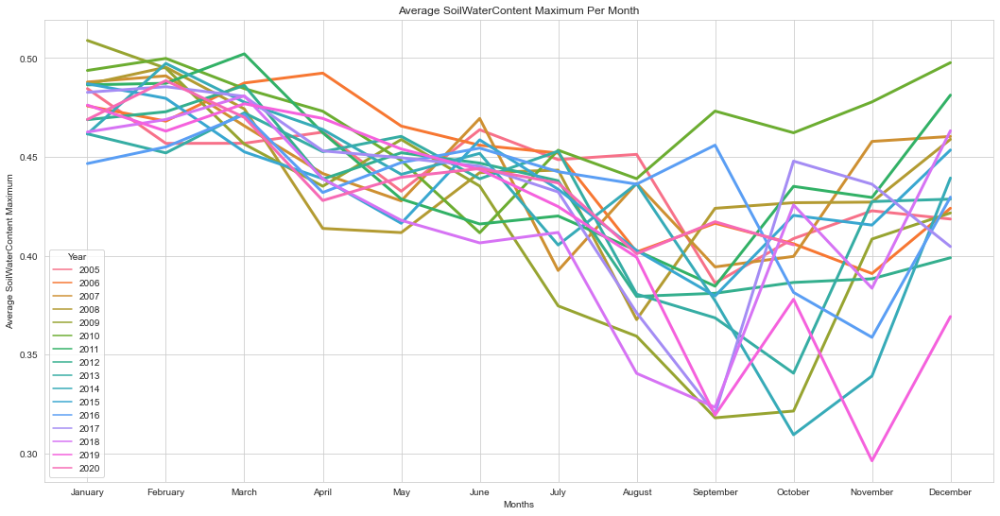

In [24]:
df_SoilWaterContent_QL = weather_QL[['Region', 'Date' ,'SoilWaterContent_min', 'SoilWaterContent_max']].copy()
df_SoilWaterContent_QL.drop_duplicates(inplace=True)
df_SoilWaterContent_QL.sort_values(by=['Region', 'Date'])
df_SoilWaterContent_QL.reset_index(drop=True, inplace=True)

df_SoilWaterContent_QL['year'] = df_SoilWaterContent_QL['Date'].dt.year
df_SoilWaterContent_QL['month'] = df_SoilWaterContent_QL['Date'].dt.month
df_SoilWaterContent_QL['month_name'] = df_SoilWaterContent_QL['Date'].dt.strftime('%B')

df_p = df_SoilWaterContent_QL.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'SoilWaterContent'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### SOLAR RADIATION Min & Max over Time - Year by Year

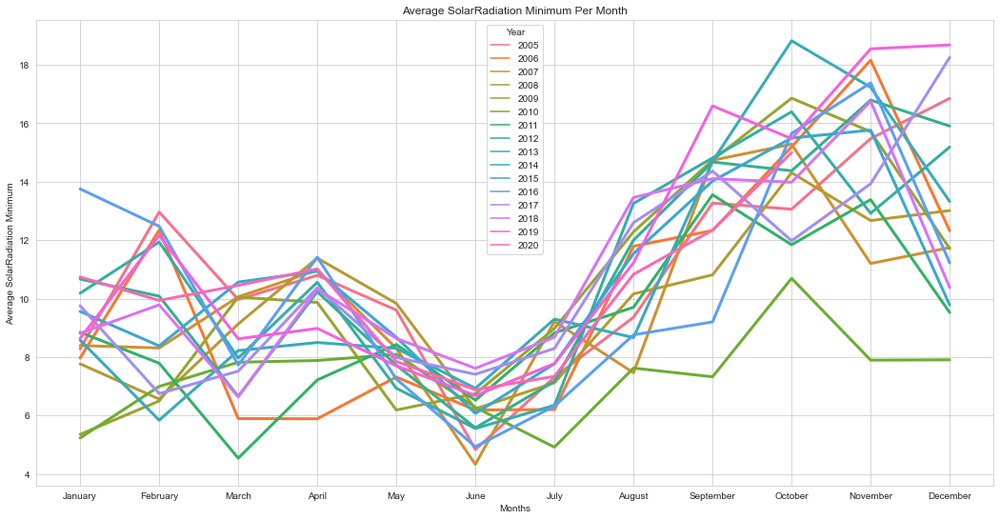

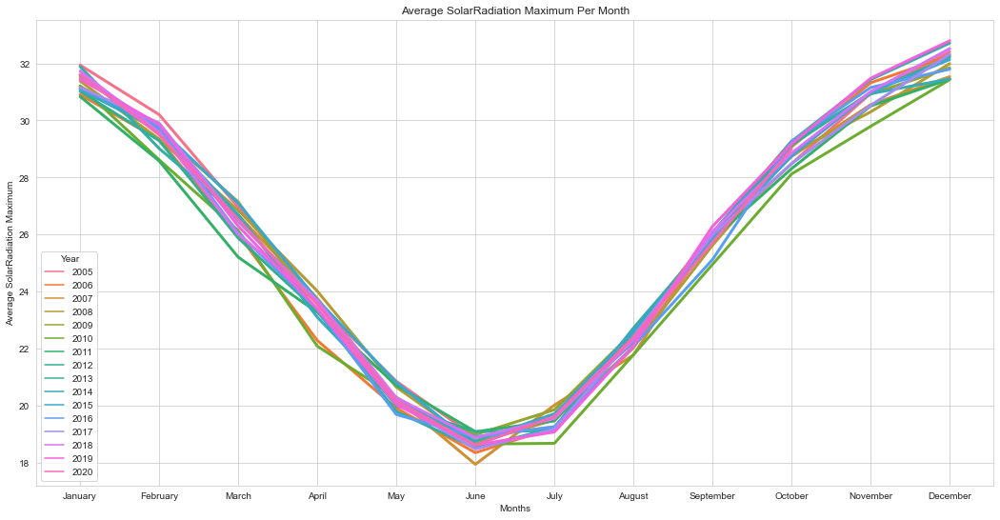

In [25]:
df_SolarRadiation_QL = weather_QL[['Region', 'Date' ,'SolarRadiation_min', 'SolarRadiation_max']].copy()
df_SolarRadiation_QL.drop_duplicates(inplace=True)
df_SolarRadiation_QL.sort_values(by=['Region', 'Date'])
df_SolarRadiation_QL.reset_index(drop=True, inplace=True)

df_SolarRadiation_QL['year'] = df_SolarRadiation_QL['Date'].dt.year
df_SolarRadiation_QL['month'] = df_SolarRadiation_QL['Date'].dt.month
df_SolarRadiation_QL['month_name'] = df_SolarRadiation_QL['Date'].dt.strftime('%B')

df_p = df_SolarRadiation_QL.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'SolarRadiation'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### TEMPERATURE Min & Max over Time - Year by Year 

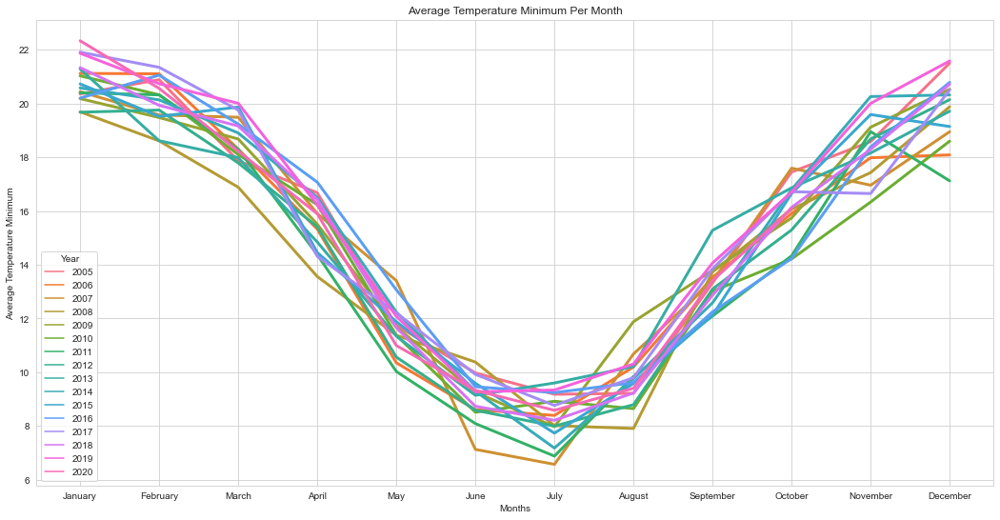

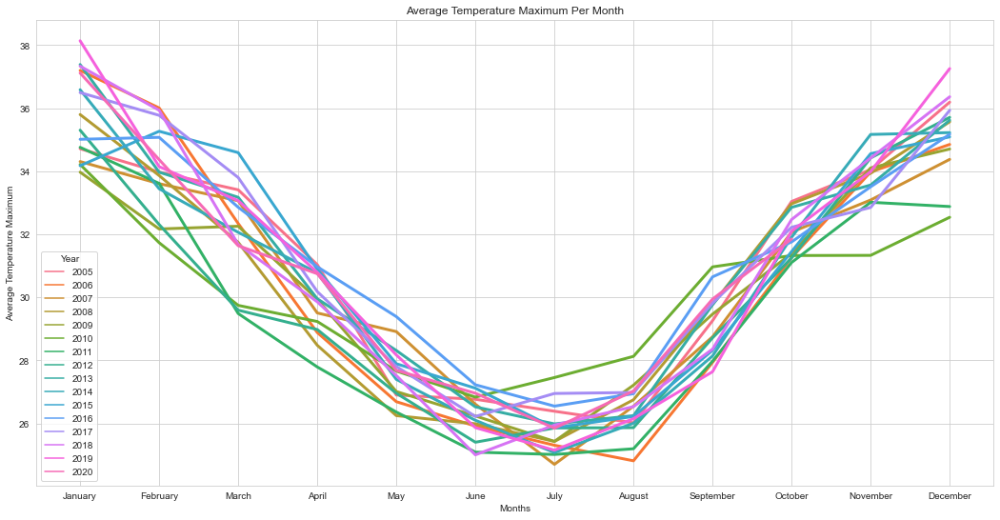

In [26]:
df_Temperature_QL = weather_QL[['Region', 'Date' ,'Temperature_min', 'Temperature_max']].copy()
df_Temperature_QL.drop_duplicates(inplace=True)
df_Temperature_QL.sort_values(by=['Region', 'Date'])
df_Temperature_QL.reset_index(drop=True, inplace=True)

df_Temperature_QL['year'] = df_Temperature_QL['Date'].dt.year
df_Temperature_QL['month'] = df_Temperature_QL['Date'].dt.month
df_Temperature_QL['month_name'] = df_Temperature_QL['Date'].dt.strftime('%B')

df_p = df_Temperature_QL.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'Temperature'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### WINDSPEED Min & Max over Time - Year by Year 

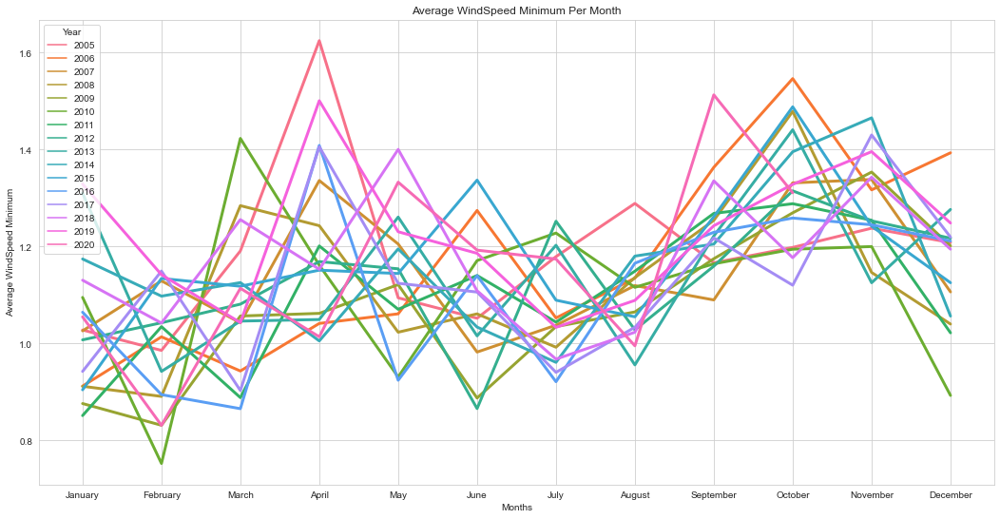

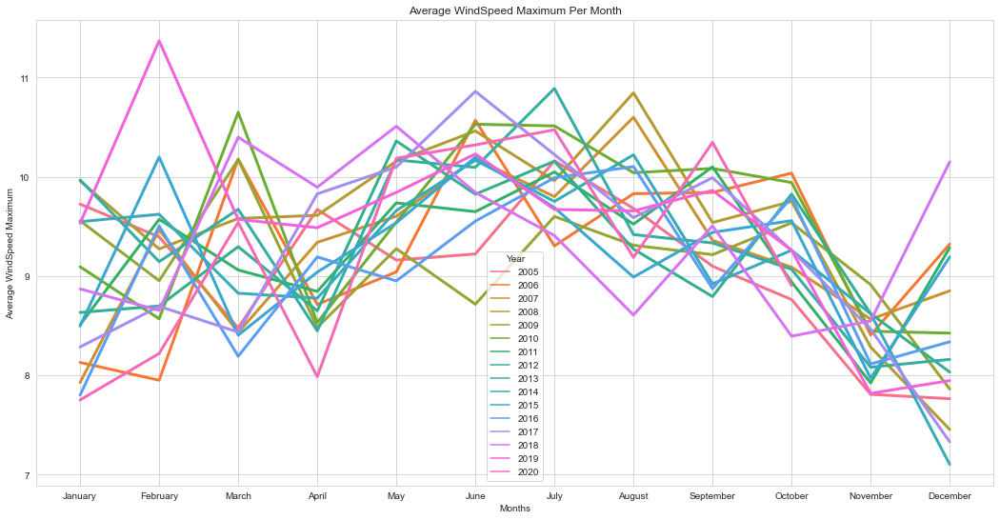

In [27]:
df_WindSpeed_QL = weather_QL[['Region', 'Date' ,'WindSpeed_min', 'WindSpeed_max']].copy()
df_WindSpeed_QL.drop_duplicates(inplace=True)
df_WindSpeed_QL.sort_values(by=['Region', 'Date'])
df_WindSpeed_QL.reset_index(drop=True, inplace=True)

df_WindSpeed_QL['year'] = df_WindSpeed_QL['Date'].dt.year
df_WindSpeed_QL['month'] = df_WindSpeed_QL['Date'].dt.month
df_WindSpeed_QL['month_name'] = df_WindSpeed_QL['Date'].dt.strftime('%B')

df_p = df_WindSpeed_QL.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'WindSpeed'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### SA Region <a class="anchor" id="SA"></a>

In [28]:
weather_SA = weather_df.loc[weather_df['Region'] == 'SA']
weather_SA.shape

(5783, 27)

### PRECIPITATION Min & Max over Time - Year by Year 

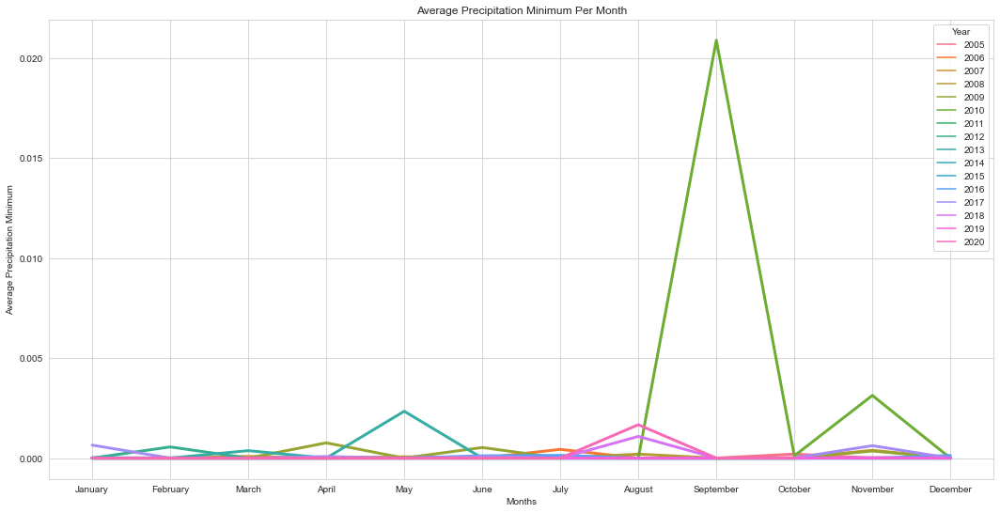

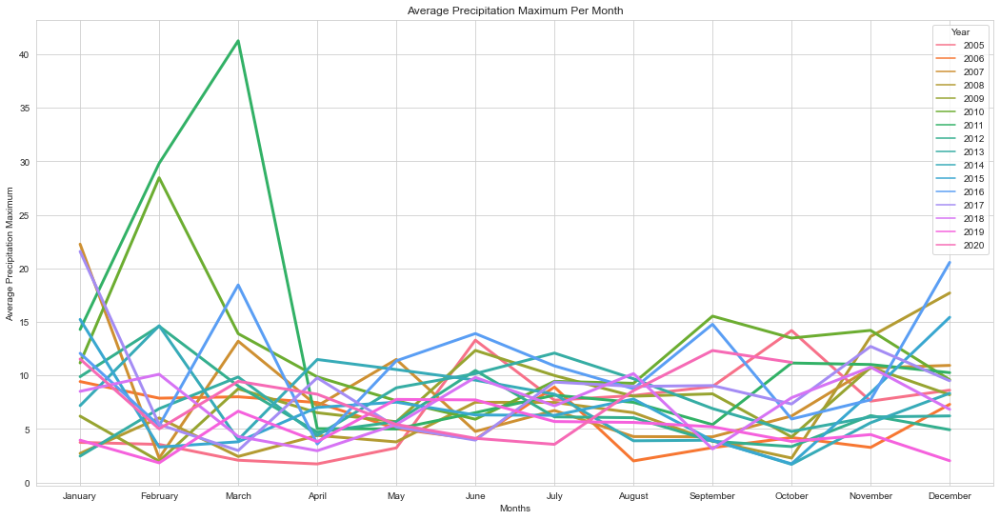

In [29]:
df_precipitation_SA = weather_SA[['Region', 'Date' ,'Precipitation_min', 'Precipitation_max',]].copy()
df_precipitation_SA.drop_duplicates(inplace=True)
df_precipitation_SA.sort_values(by=['Region', 'Date'])
df_precipitation_SA.reset_index(drop=True, inplace=True)

df_precipitation_SA['year'] = df_precipitation_SA['Date'].dt.year
df_precipitation_SA['month'] = df_precipitation_SA['Date'].dt.month
df_precipitation_SA['month_name'] = df_precipitation_SA['Date'].dt.strftime('%B')

df_p = df_precipitation_SA.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'Precipitation'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### RELATIVE HUMIDITY Min & Max over Time - Year by Year 

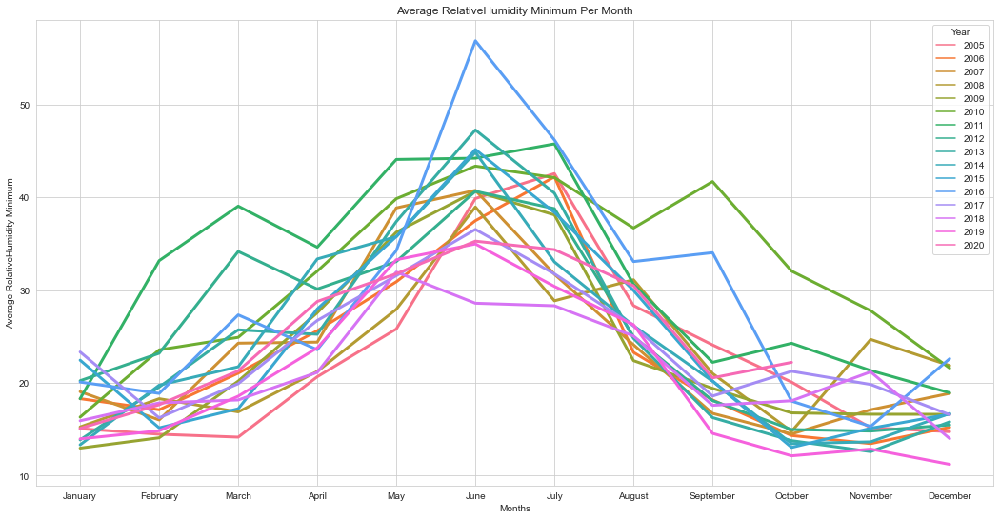

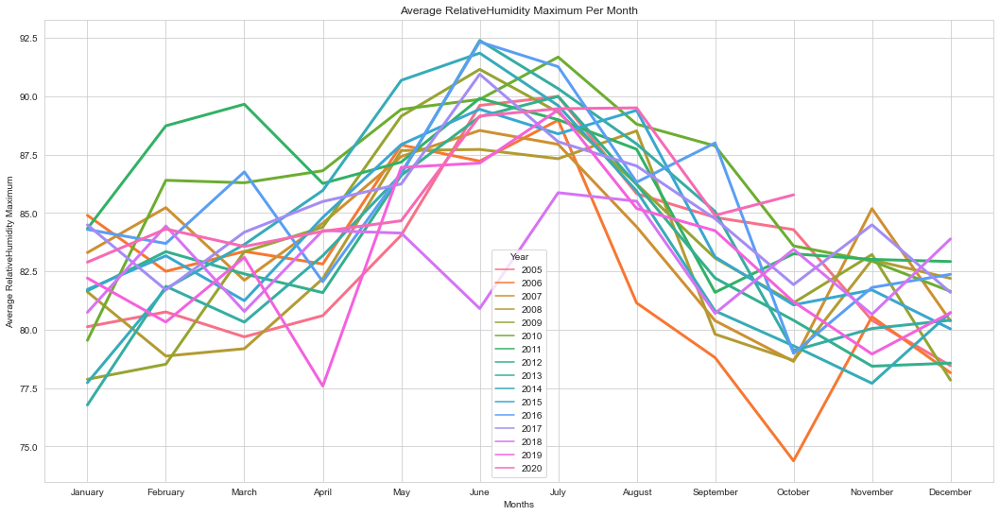

In [30]:
df_RelativeHumidity_SA = weather_SA[['Region', 'Date' ,'RelativeHumidity_min', 'RelativeHumidity_max']].copy()
df_RelativeHumidity_SA.drop_duplicates(inplace=True)
df_RelativeHumidity_SA.sort_values(by=['Region', 'Date'])
df_RelativeHumidity_SA.reset_index(drop=True, inplace=True)

df_RelativeHumidity_SA['year'] = df_RelativeHumidity_SA['Date'].dt.year
df_RelativeHumidity_SA['month'] = df_RelativeHumidity_SA['Date'].dt.month
df_RelativeHumidity_SA['month_name'] = df_RelativeHumidity_SA['Date'].dt.strftime('%B')

df_p = df_RelativeHumidity_SA.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'RelativeHumidity'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### SOIL WATER CONTENT Min & Max over Time - Year by Year 

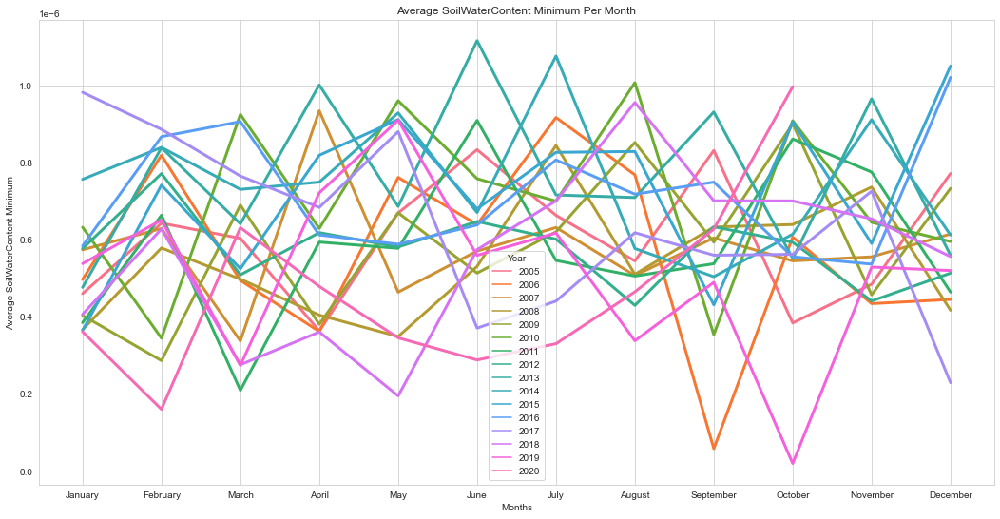

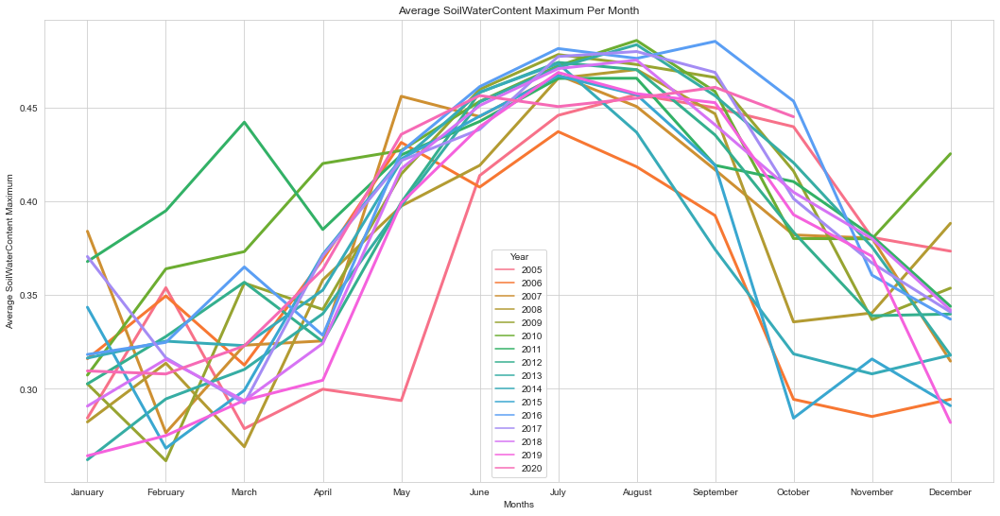

In [31]:
df_SoilWaterContent_SA = weather_SA[['Region', 'Date' ,'SoilWaterContent_min', 'SoilWaterContent_max']].copy()
df_SoilWaterContent_SA.drop_duplicates(inplace=True)
df_SoilWaterContent_SA.sort_values(by=['Region', 'Date'])
df_SoilWaterContent_SA.reset_index(drop=True, inplace=True)

df_SoilWaterContent_SA['year'] = df_SoilWaterContent_SA['Date'].dt.year
df_SoilWaterContent_SA['month'] = df_SoilWaterContent_SA['Date'].dt.month
df_SoilWaterContent_SA['month_name'] = df_SoilWaterContent_SA['Date'].dt.strftime('%B')

df_p = df_SoilWaterContent_SA.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'SoilWaterContent'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### SOLAR RADIATION Min & Max over Time - Year by Year

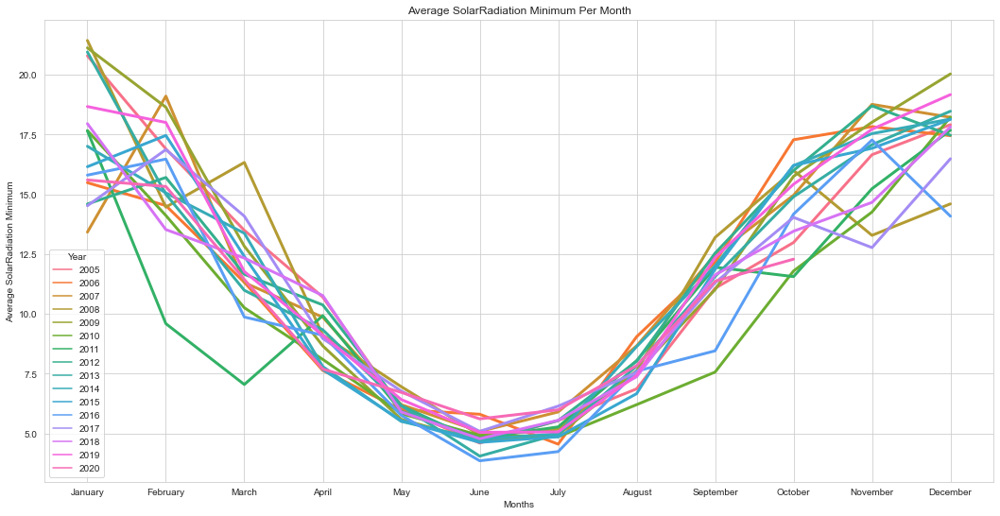

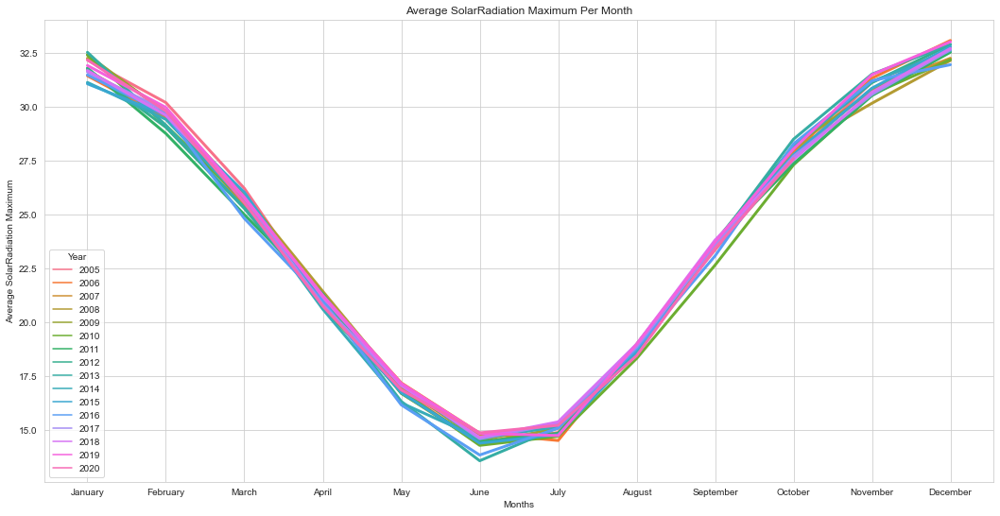

In [32]:
df_SolarRadiation_SA = weather_SA[['Region', 'Date' ,'SolarRadiation_min', 'SolarRadiation_max']].copy()
df_SolarRadiation_SA.drop_duplicates(inplace=True)
df_SolarRadiation_SA.sort_values(by=['Region', 'Date'])
df_SolarRadiation_SA.reset_index(drop=True, inplace=True)

df_SolarRadiation_SA['year'] = df_SolarRadiation_SA['Date'].dt.year
df_SolarRadiation_SA['month'] = df_SolarRadiation_SA['Date'].dt.month
df_SolarRadiation_SA['month_name'] = df_SolarRadiation_SA['Date'].dt.strftime('%B')

df_p = df_SolarRadiation_SA.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'SolarRadiation'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### TEMPERATURE Min & Max over Time - Year by Year 

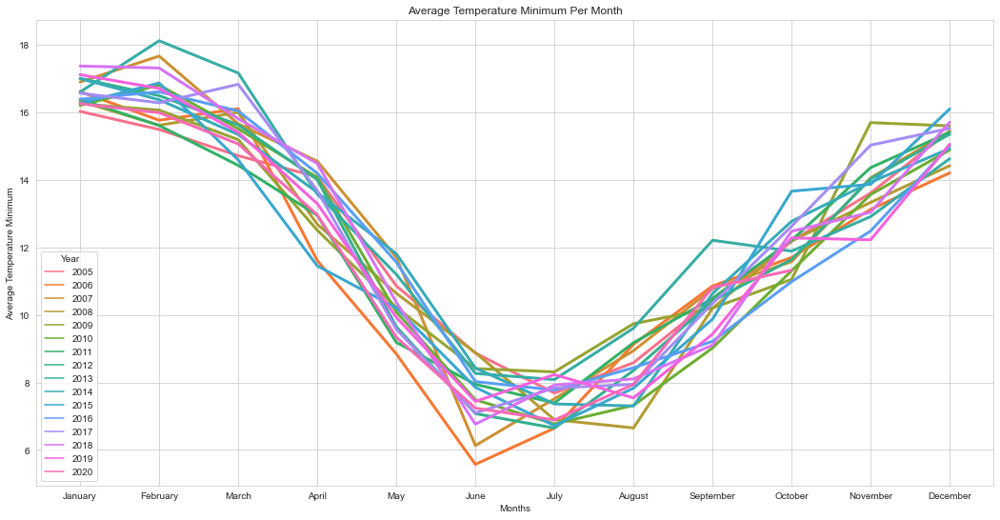

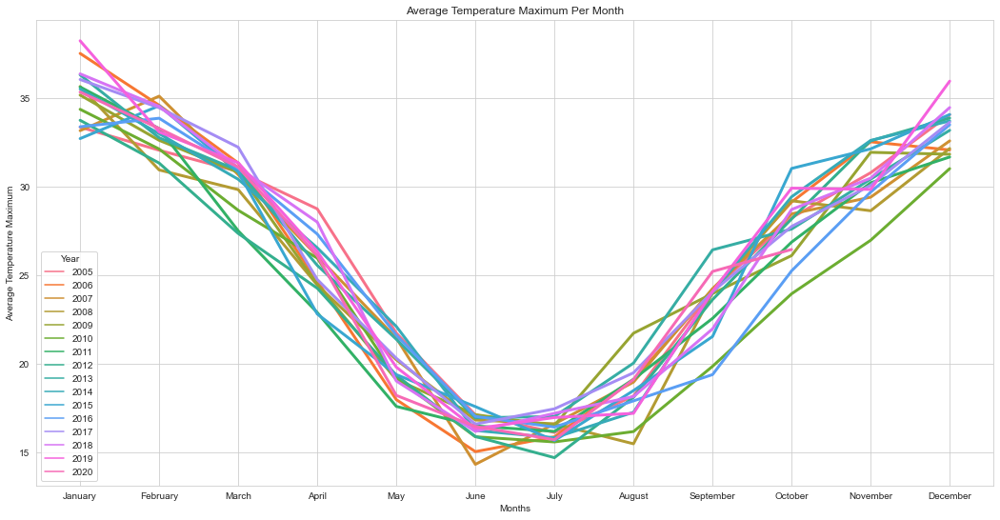

In [33]:
df_Temperature_SA = weather_SA[['Region', 'Date' ,'Temperature_min', 'Temperature_max']].copy()
df_Temperature_SA.drop_duplicates(inplace=True)
df_Temperature_SA.sort_values(by=['Region', 'Date'])
df_Temperature_SA.reset_index(drop=True, inplace=True)

df_Temperature_SA['year'] = df_Temperature_SA['Date'].dt.year
df_Temperature_SA['month'] = df_Temperature_SA['Date'].dt.month
df_Temperature_SA['month_name'] = df_Temperature_SA['Date'].dt.strftime('%B')

df_p = df_Temperature_SA.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'Temperature'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### WINDSPEED Min & Max over Time - Year by Year 

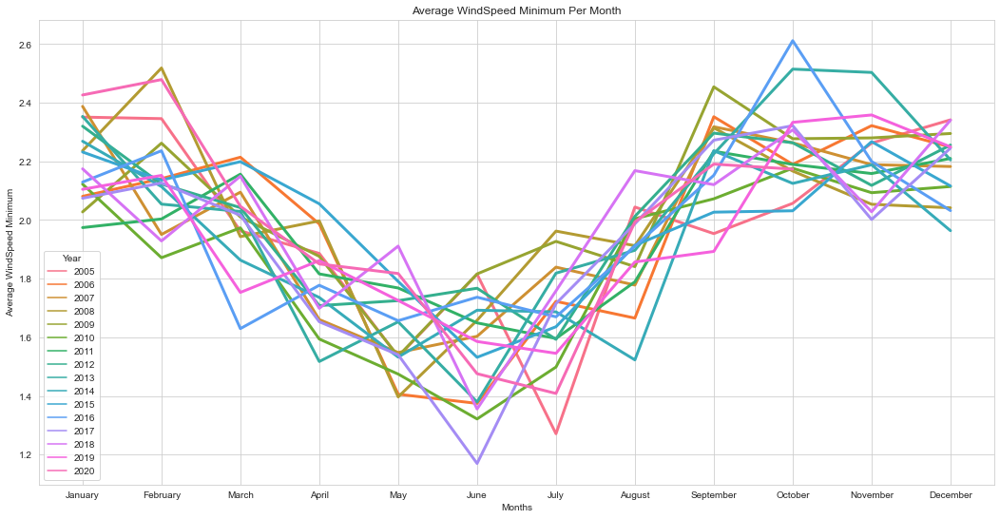

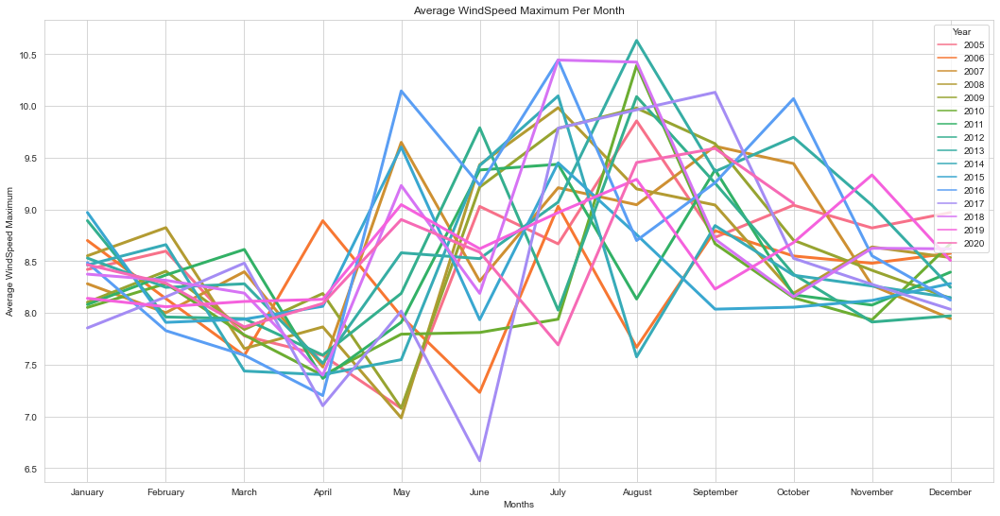

In [34]:
df_WindSpeed_SA = weather_SA[['Region', 'Date' ,'WindSpeed_min', 'WindSpeed_max']].copy()
df_WindSpeed_SA.drop_duplicates(inplace=True)
df_WindSpeed_SA.sort_values(by=['Region', 'Date'])
df_WindSpeed_SA.reset_index(drop=True, inplace=True)

df_WindSpeed_SA['year'] = df_WindSpeed_SA['Date'].dt.year
df_WindSpeed_SA['month'] = df_WindSpeed_SA['Date'].dt.month
df_WindSpeed_SA['month_name'] = df_WindSpeed_SA['Date'].dt.strftime('%B')

df_p = df_WindSpeed_SA.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'WindSpeed'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### TA Region <a class="anchor" id="TA"></a>

In [35]:
weather_TA = weather_df.loc[weather_df['Region'] == 'TA']
weather_TA.shape

(5783, 27)

### PRECIPITATION Min & Max over Time - Year by Year 

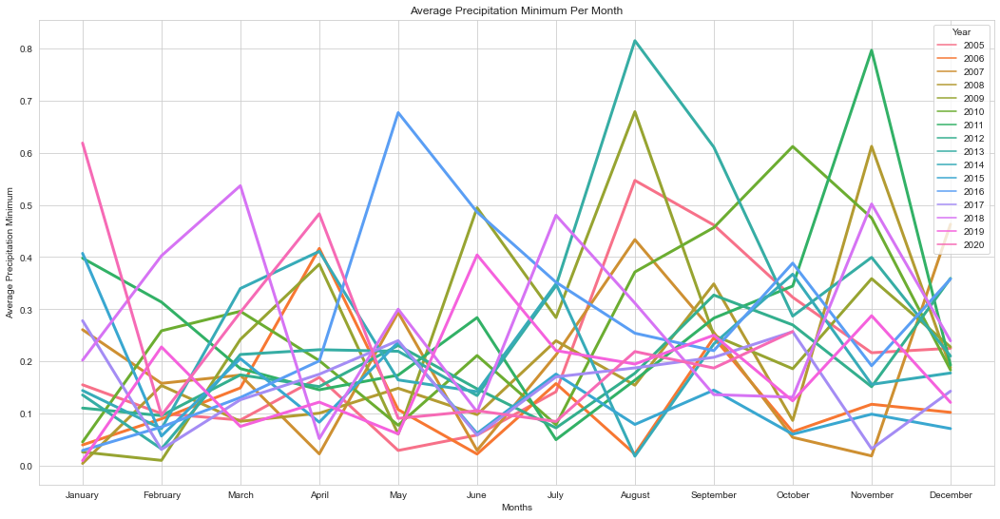

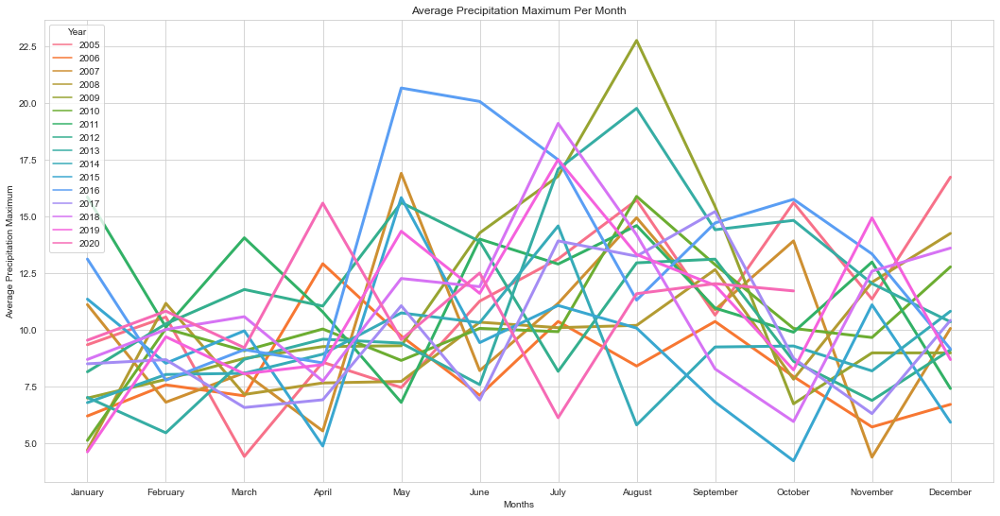

In [36]:
df_precipitation_TA = weather_TA[['Region', 'Date' ,'Precipitation_min', 'Precipitation_max',]].copy()
df_precipitation_TA.drop_duplicates(inplace=True)
df_precipitation_TA.sort_values(by=['Region', 'Date'])
df_precipitation_TA.reset_index(drop=True, inplace=True)

df_precipitation_TA['year'] = df_precipitation_TA['Date'].dt.year
df_precipitation_TA['month'] = df_precipitation_TA['Date'].dt.month
df_precipitation_TA['month_name'] = df_precipitation_TA['Date'].dt.strftime('%B')

df_p = df_precipitation_TA.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'Precipitation'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### RELATIVE HUMIDITY Min & Max over Time - Year by Year 

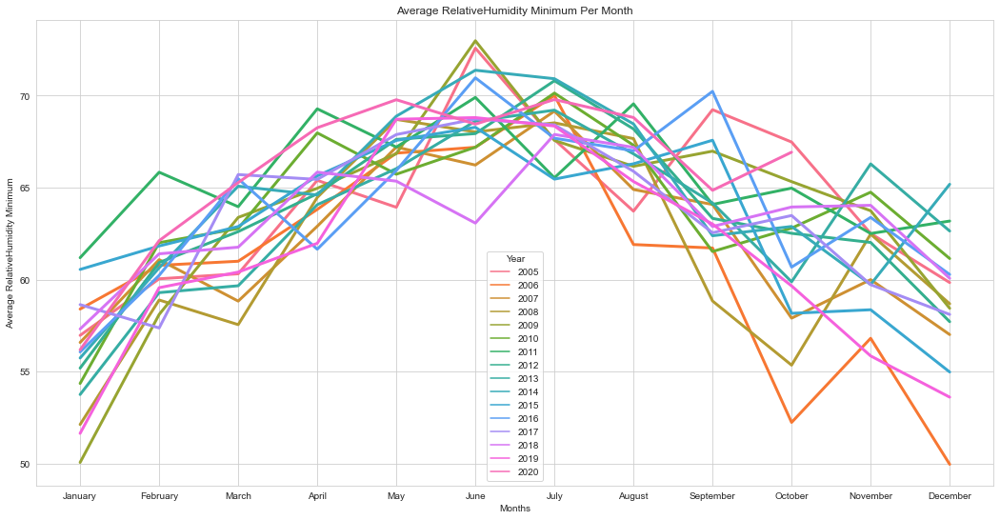

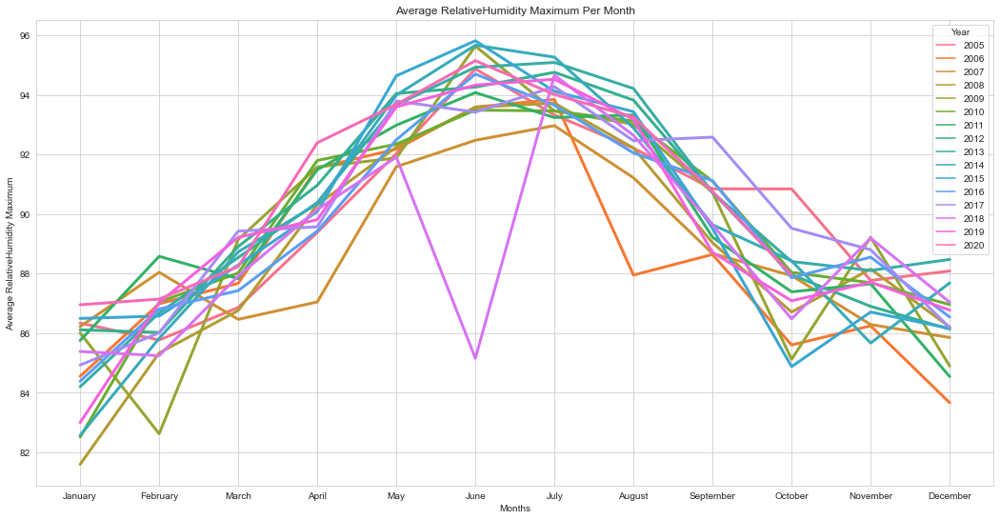

In [37]:
df_RelativeHumidity_TA= weather_TA[['Region', 'Date' ,'RelativeHumidity_min', 'RelativeHumidity_max']].copy()
df_RelativeHumidity_TA.drop_duplicates(inplace=True)
df_RelativeHumidity_TA.sort_values(by=['Region', 'Date'])
df_RelativeHumidity_TA.reset_index(drop=True, inplace=True)

df_RelativeHumidity_TA['year'] = df_RelativeHumidity_TA['Date'].dt.year
df_RelativeHumidity_TA['month'] = df_RelativeHumidity_TA['Date'].dt.month
df_RelativeHumidity_TA['month_name'] = df_RelativeHumidity_TA['Date'].dt.strftime('%B')

df_p = df_RelativeHumidity_TA.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'RelativeHumidity'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### SOIL WATER CONTENT Min & Max over Time - Year by Year 

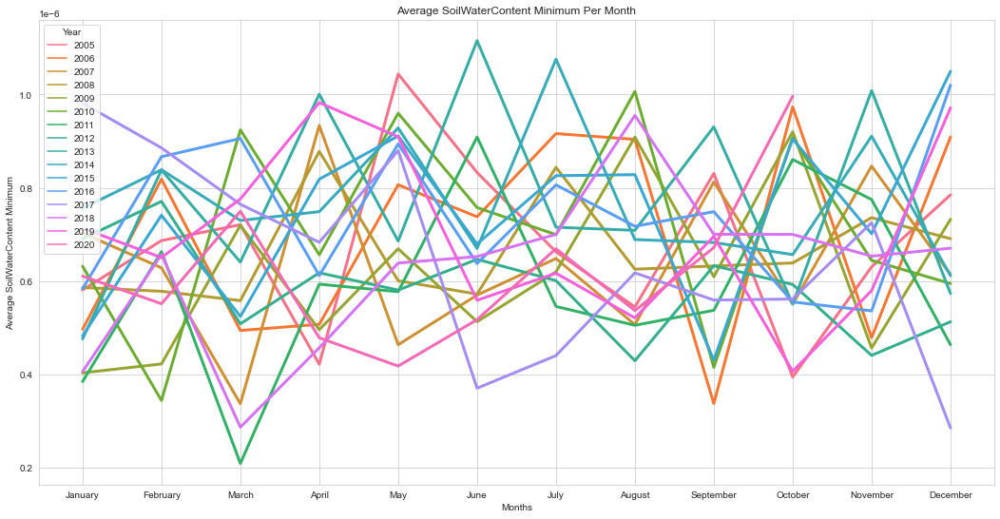

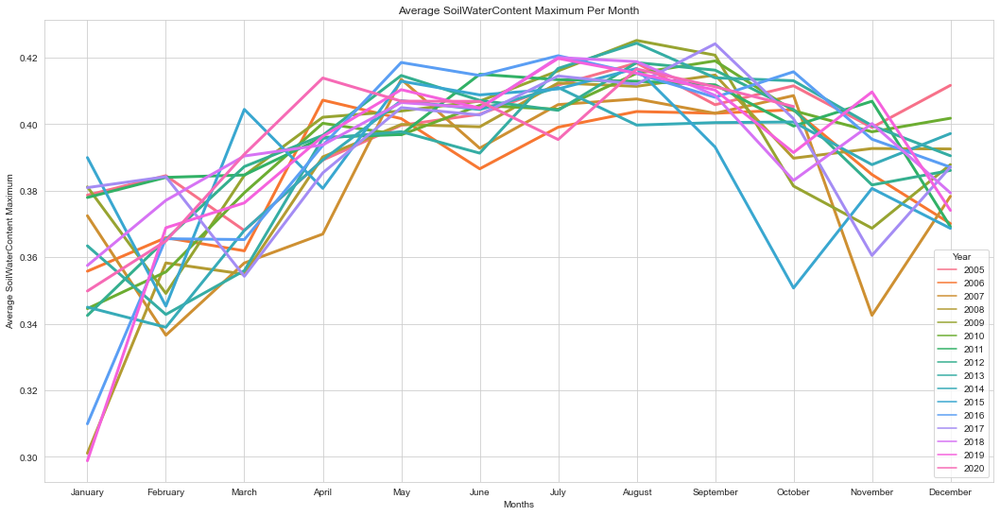

In [38]:
df_SoilWaterContent_TA = weather_TA[['Region', 'Date' ,'SoilWaterContent_min', 'SoilWaterContent_max']].copy()
df_SoilWaterContent_TA.drop_duplicates(inplace=True)
df_SoilWaterContent_TA.sort_values(by=['Region', 'Date'])
df_SoilWaterContent_TA.reset_index(drop=True, inplace=True)

df_SoilWaterContent_TA['year'] = df_SoilWaterContent_TA['Date'].dt.year
df_SoilWaterContent_TA['month'] = df_SoilWaterContent_TA['Date'].dt.month
df_SoilWaterContent_TA['month_name'] = df_SoilWaterContent_TA['Date'].dt.strftime('%B')

df_p = df_SoilWaterContent_TA.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'SoilWaterContent'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### SOLAR RADIATION Min & Max over Time - Year by Year

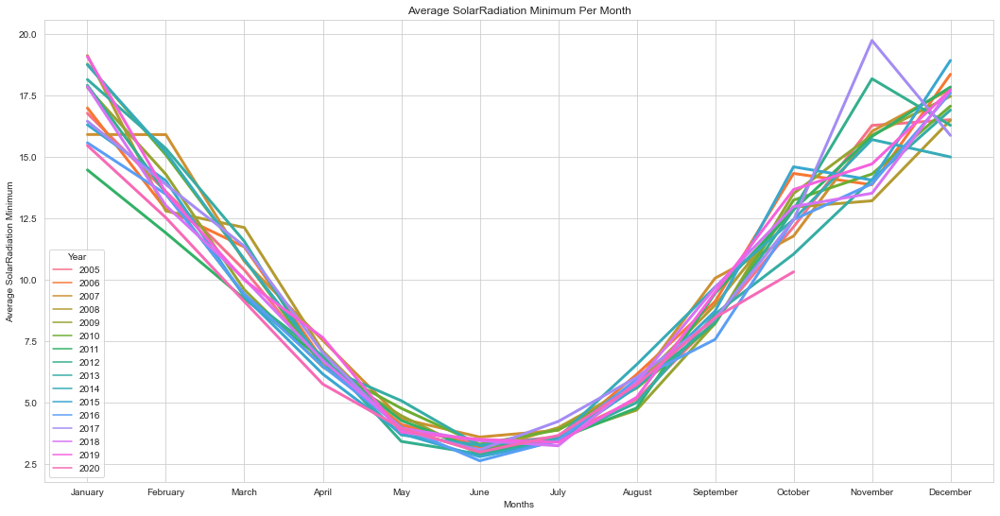

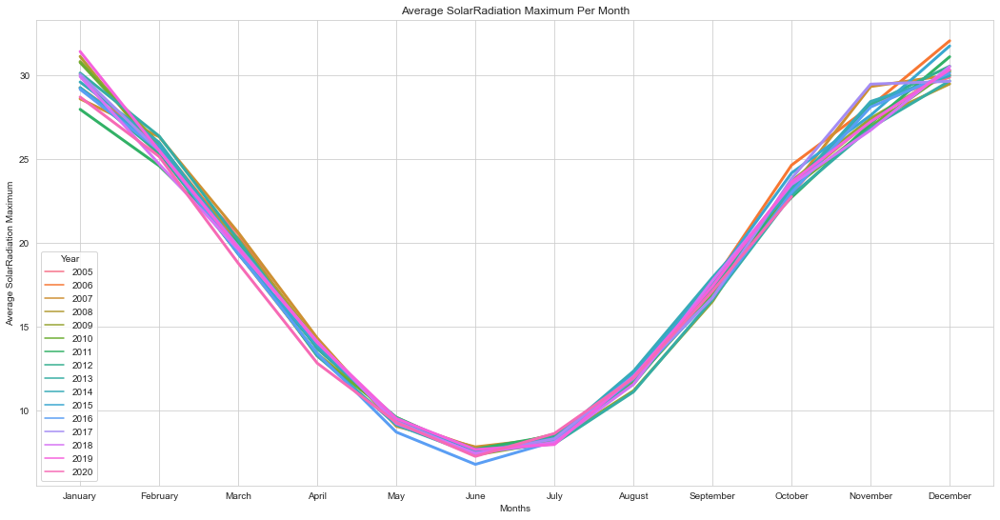

In [39]:
df_SolarRadiation_TA = weather_TA[['Region', 'Date' ,'SolarRadiation_min', 'SolarRadiation_max']].copy()
df_SolarRadiation_TA.drop_duplicates(inplace=True)
df_SolarRadiation_TA.sort_values(by=['Region', 'Date'])
df_SolarRadiation_TA.reset_index(drop=True, inplace=True)

df_SolarRadiation_TA['year'] = df_SolarRadiation_TA['Date'].dt.year
df_SolarRadiation_TA['month'] = df_SolarRadiation_TA['Date'].dt.month
df_SolarRadiation_TA['month_name'] = df_SolarRadiation_TA['Date'].dt.strftime('%B')

df_p = df_SolarRadiation_TA.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'SolarRadiation'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### TEMPERATURE Min & Max over Time - Year by Year 

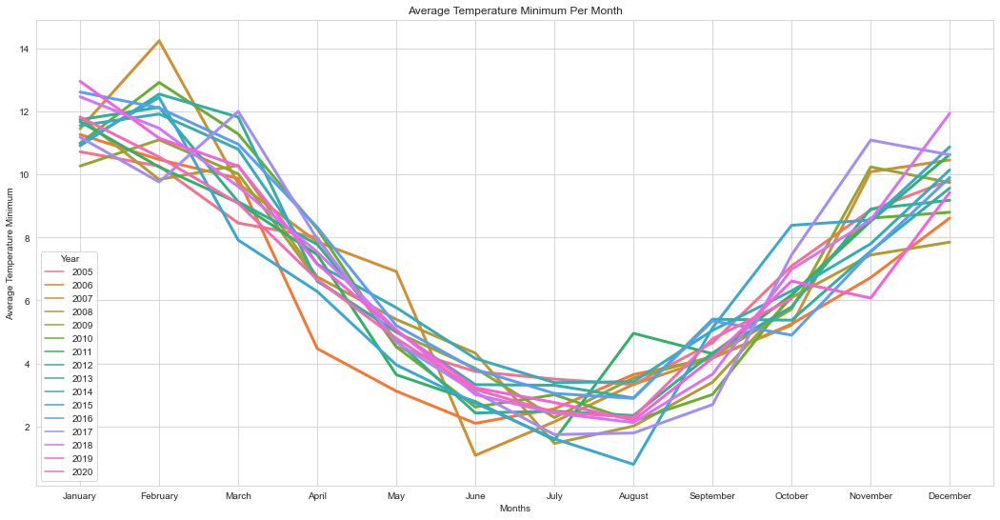

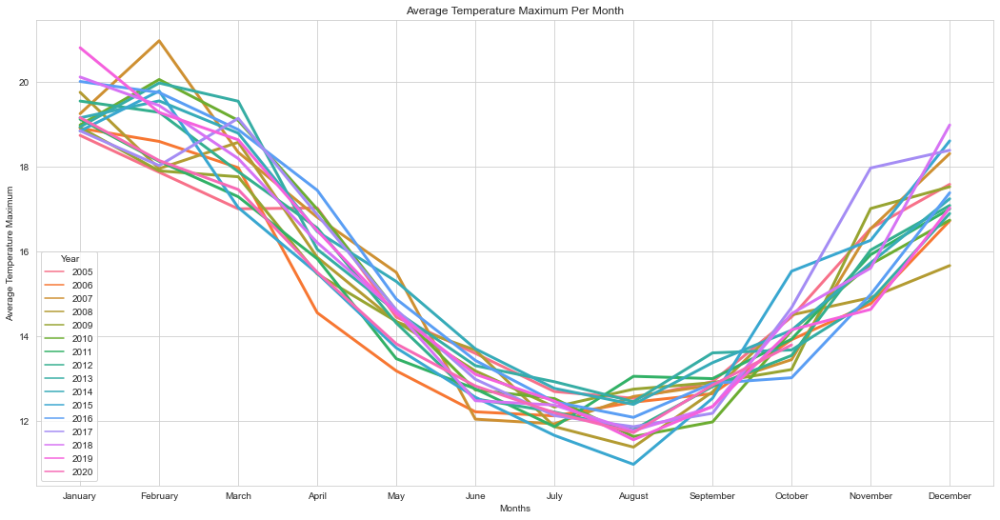

In [40]:
df_Temperature_TA = weather_TA[['Region', 'Date' ,'Temperature_min', 'Temperature_max']].copy()
df_Temperature_TA.drop_duplicates(inplace=True)
df_Temperature_TA.sort_values(by=['Region', 'Date'])
df_Temperature_TA.reset_index(drop=True, inplace=True)

df_Temperature_TA['year'] = df_Temperature_TA['Date'].dt.year
df_Temperature_TA['month'] = df_Temperature_TA['Date'].dt.month
df_Temperature_TA['month_name'] = df_Temperature_TA['Date'].dt.strftime('%B')

df_p = df_Temperature_TA.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'Temperature'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### WINDSPEED Min & Max over Time - Year by Year 

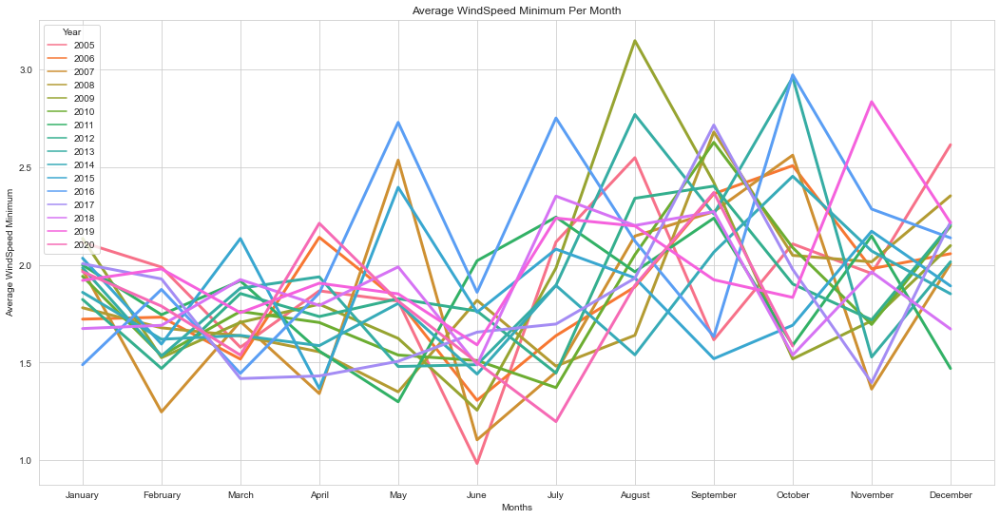

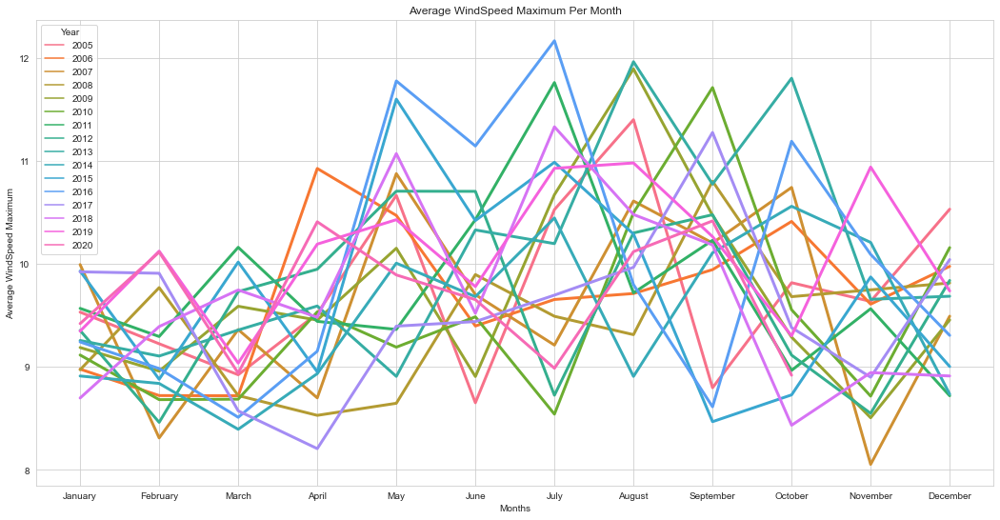

In [41]:
df_WindSpeed_TA = weather_TA[['Region', 'Date' ,'WindSpeed_min', 'WindSpeed_max']].copy()
df_WindSpeed_TA.drop_duplicates(inplace=True)
df_WindSpeed_TA.sort_values(by=['Region', 'Date'])
df_WindSpeed_TA.reset_index(drop=True, inplace=True)

df_WindSpeed_TA['year'] = df_WindSpeed_TA['Date'].dt.year
df_WindSpeed_TA['month'] = df_WindSpeed_TA['Date'].dt.month
df_WindSpeed_TA['month_name'] = df_WindSpeed_TA['Date'].dt.strftime('%B')

df_p = df_WindSpeed_TA.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'WindSpeed'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### VI Region <a class="anchor" id="VI"></a>

In [42]:
weather_VI = weather_df.loc[weather_df['Region'] == 'VI']
weather_VI.shape

(5783, 27)

### PRECIPITATION Min & Max over Time - Year by Year 

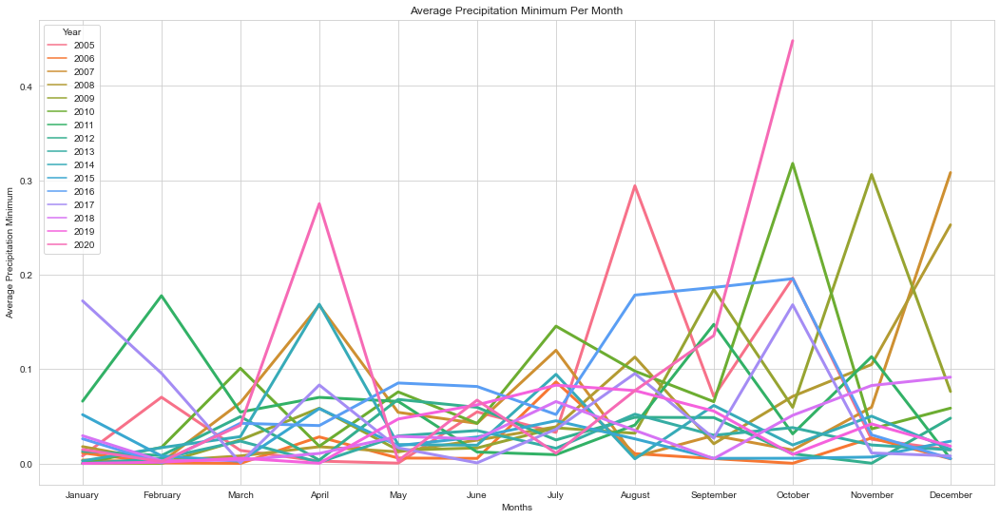

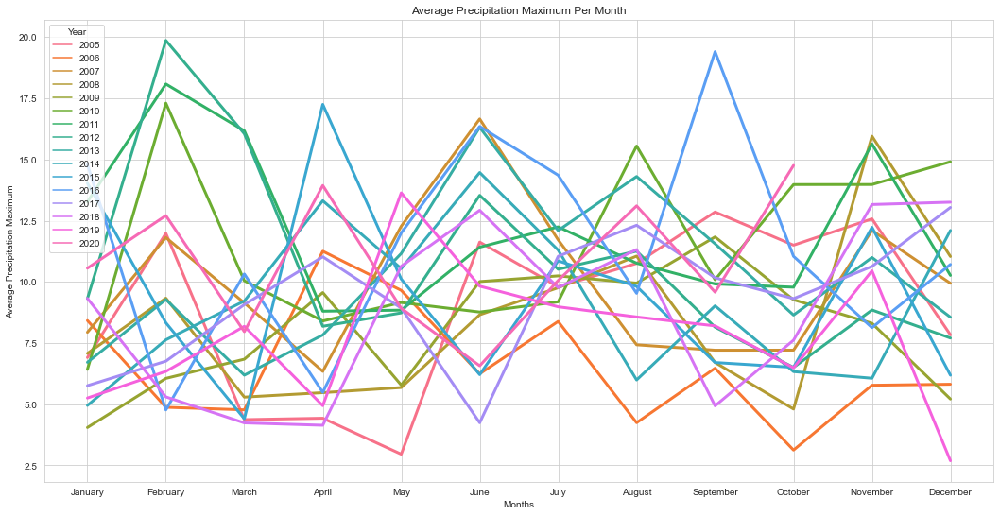

In [43]:
df_precipitation_VI = weather_VI[['Region', 'Date' ,'Precipitation_min', 'Precipitation_max',]].copy()
df_precipitation_VI.drop_duplicates(inplace=True)
df_precipitation_VI.sort_values(by=['Region', 'Date'])
df_precipitation_VI.reset_index(drop=True, inplace=True)

df_precipitation_VI['year'] = df_precipitation_VI['Date'].dt.year
df_precipitation_VI['month'] = df_precipitation_VI['Date'].dt.month
df_precipitation_VI['month_name'] = df_precipitation_VI['Date'].dt.strftime('%B')

df_p = df_precipitation_VI.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'Precipitation'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### RELATIVE HUMIDITY Min & Max over Time - Year by Year 

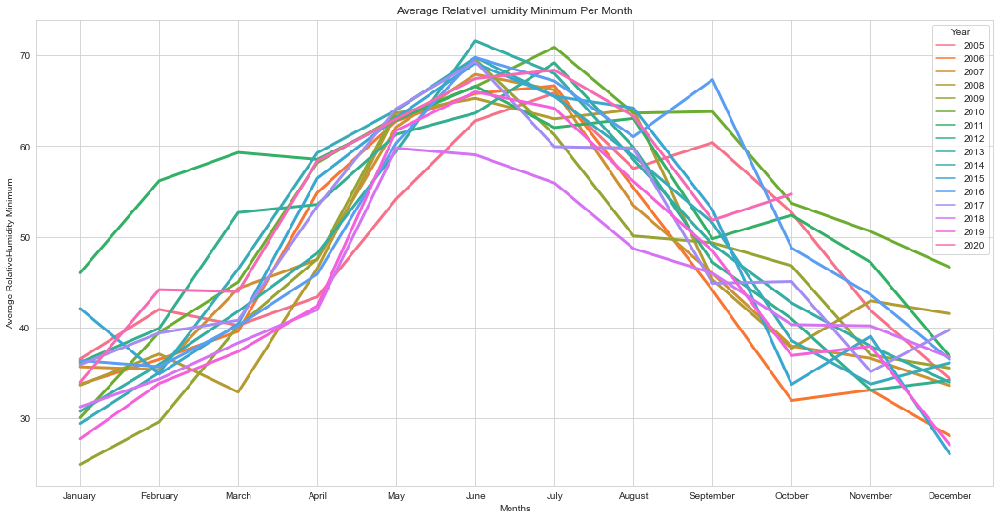

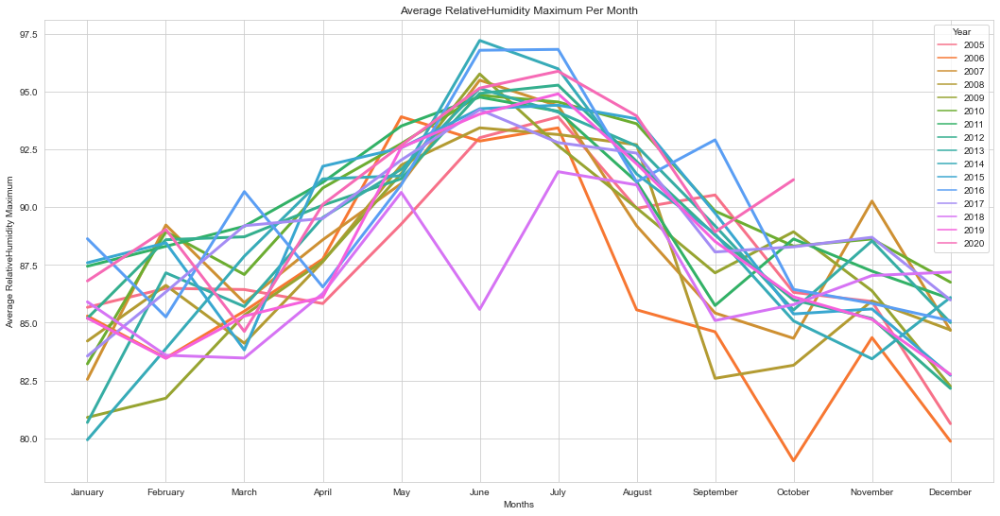

In [44]:
df_RelativeHumidity_VI= weather_VI[['Region', 'Date' ,'RelativeHumidity_min', 'RelativeHumidity_max']].copy()
df_RelativeHumidity_VI.drop_duplicates(inplace=True)
df_RelativeHumidity_VI.sort_values(by=['Region', 'Date'])
df_RelativeHumidity_VI.reset_index(drop=True, inplace=True)

df_RelativeHumidity_VI['year'] = df_RelativeHumidity_VI['Date'].dt.year
df_RelativeHumidity_VI['month'] = df_RelativeHumidity_VI['Date'].dt.month
df_RelativeHumidity_VI['month_name'] = df_RelativeHumidity_VI['Date'].dt.strftime('%B')

df_p = df_RelativeHumidity_VI.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'RelativeHumidity'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### SOIL WATER CONTENT Min & Max over Time - Year by Year 

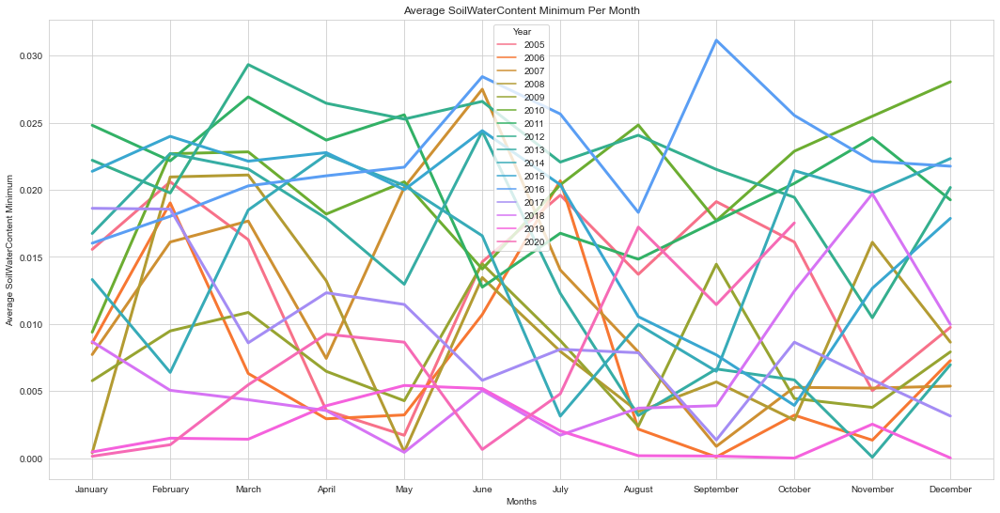

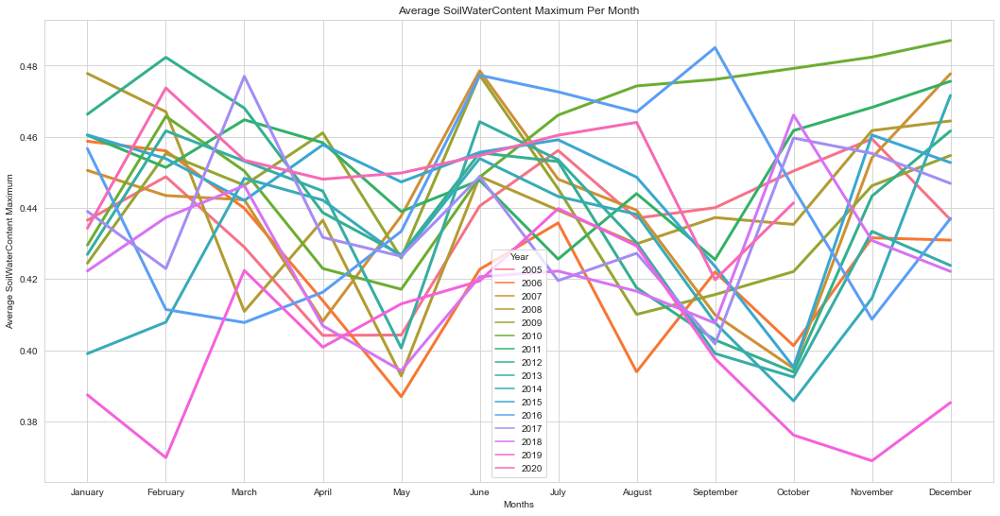

In [45]:
df_SoilWaterContent_VI = weather_NSW[['Region', 'Date' ,'SoilWaterContent_min', 'SoilWaterContent_max']].copy()
df_SoilWaterContent_VI.drop_duplicates(inplace=True)
df_SoilWaterContent_VI.sort_values(by=['Region', 'Date'])
df_SoilWaterContent_VI.reset_index(drop=True, inplace=True)

df_SoilWaterContent_VI['year'] = df_SoilWaterContent_VI['Date'].dt.year
df_SoilWaterContent_VI['month'] = df_SoilWaterContent_VI['Date'].dt.month
df_SoilWaterContent_VI['month_name'] = df_SoilWaterContent_VI['Date'].dt.strftime('%B')

df_p = df_SoilWaterContent_VI.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'SoilWaterContent'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### SOLAR RADIATION Min & Max over Time - Year by Year

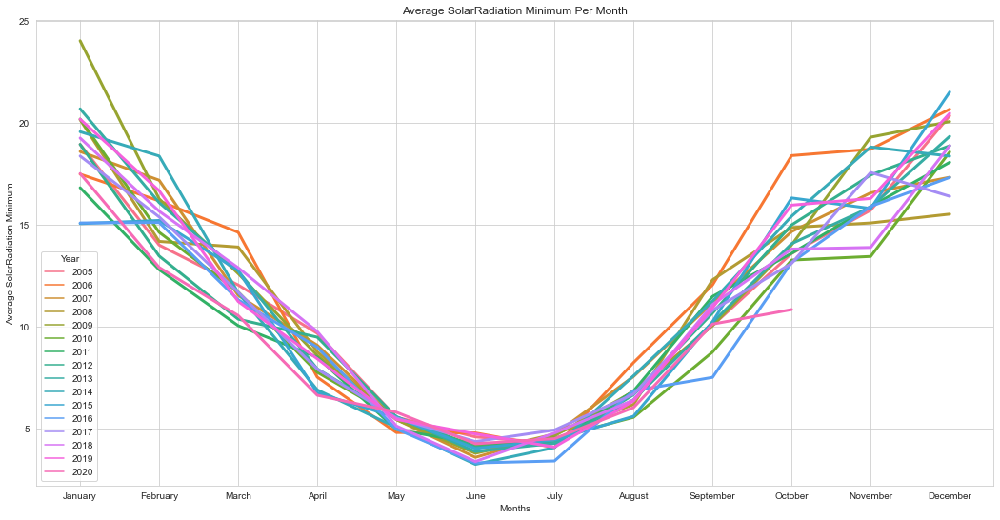

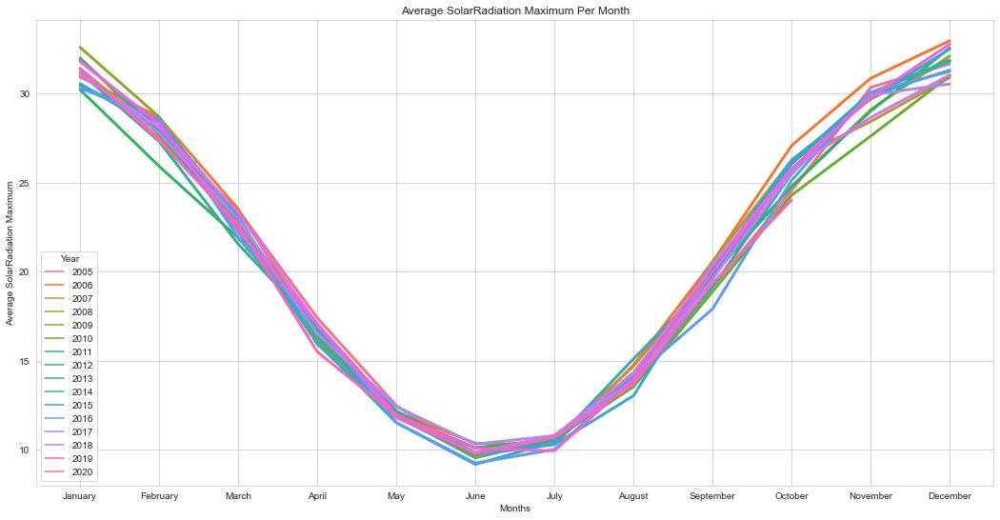

In [46]:
df_SolarRadiation_VI = weather_VI[['Region', 'Date' ,'SolarRadiation_min', 'SolarRadiation_max']].copy()
df_SolarRadiation_VI.drop_duplicates(inplace=True)
df_SolarRadiation_VI.sort_values(by=['Region', 'Date'])
df_SolarRadiation_VI.reset_index(drop=True, inplace=True)

df_SolarRadiation_VI['year'] = df_SolarRadiation_VI['Date'].dt.year
df_SolarRadiation_VI['month'] = df_SolarRadiation_VI['Date'].dt.month
df_SolarRadiation_VI['month_name'] = df_SolarRadiation_VI['Date'].dt.strftime('%B')

df_p = df_SolarRadiation_VI.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'SolarRadiation'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### TEMPERATURE Min & Max over Time - Year by Year 

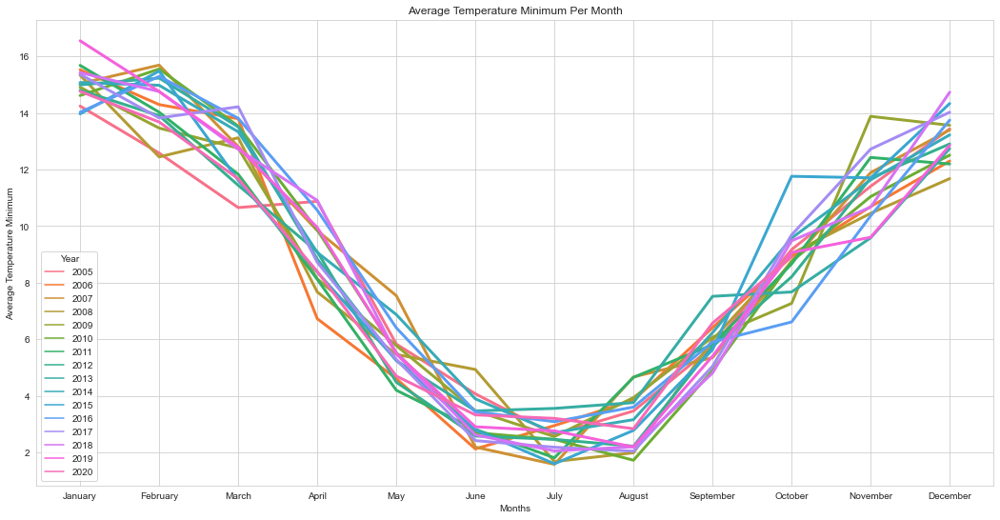

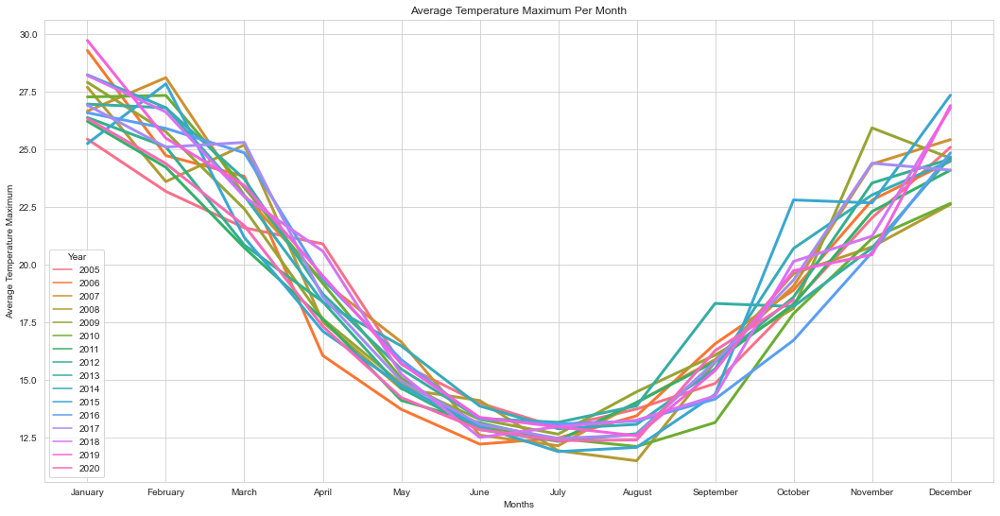

In [47]:
df_Temperature_VI = weather_VI[['Region', 'Date' ,'Temperature_min', 'Temperature_max']].copy()
df_Temperature_VI.drop_duplicates(inplace=True)
df_Temperature_VI.sort_values(by=['Region', 'Date'])
df_Temperature_VI.reset_index(drop=True, inplace=True)

df_Temperature_VI['year'] = df_Temperature_VI['Date'].dt.year
df_Temperature_VI['month'] = df_Temperature_VI['Date'].dt.month
df_Temperature_VI['month_name'] = df_Temperature_VI['Date'].dt.strftime('%B')

df_p = df_Temperature_VI.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'Temperature'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### WINDSPEED Min & Max over Time - Year by Year 

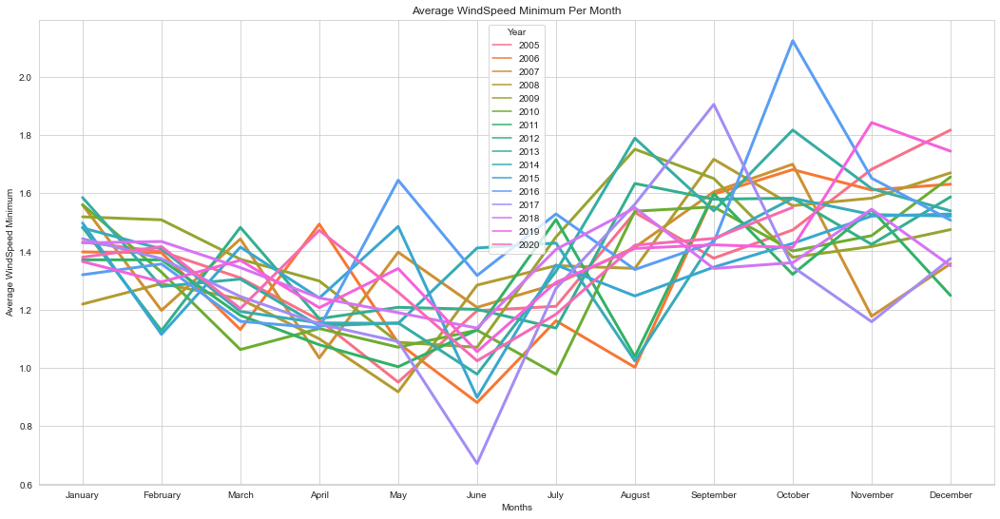

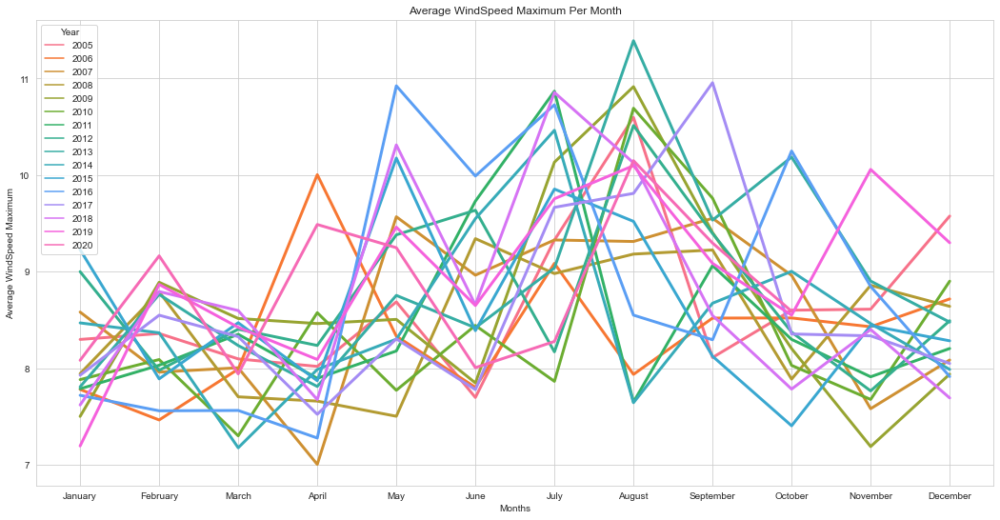

In [48]:
df_WindSpeed_VI = weather_VI[['Region', 'Date' ,'WindSpeed_min', 'WindSpeed_max']].copy()
df_WindSpeed_VI.drop_duplicates(inplace=True)
df_WindSpeed_VI.sort_values(by=['Region', 'Date'])
df_WindSpeed_VI.reset_index(drop=True, inplace=True)

df_WindSpeed_VI['year'] = df_WindSpeed_VI['Date'].dt.year
df_WindSpeed_VI['month'] = df_WindSpeed_VI['Date'].dt.month
df_WindSpeed_VI['month_name'] = df_WindSpeed_VI['Date'].dt.strftime('%B')

df_p = df_WindSpeed_VI.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'WindSpeed'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### WA Region <a class="anchor" id="WA"></a>

In [49]:
weather_WA = weather_df.loc[weather_df['Region'] == 'WA']
weather_WA.shape

(5783, 27)

### PRECIPITATION Min & Max over Time - Year by Year 
<a class="anchor" id="Precipitation"></a>

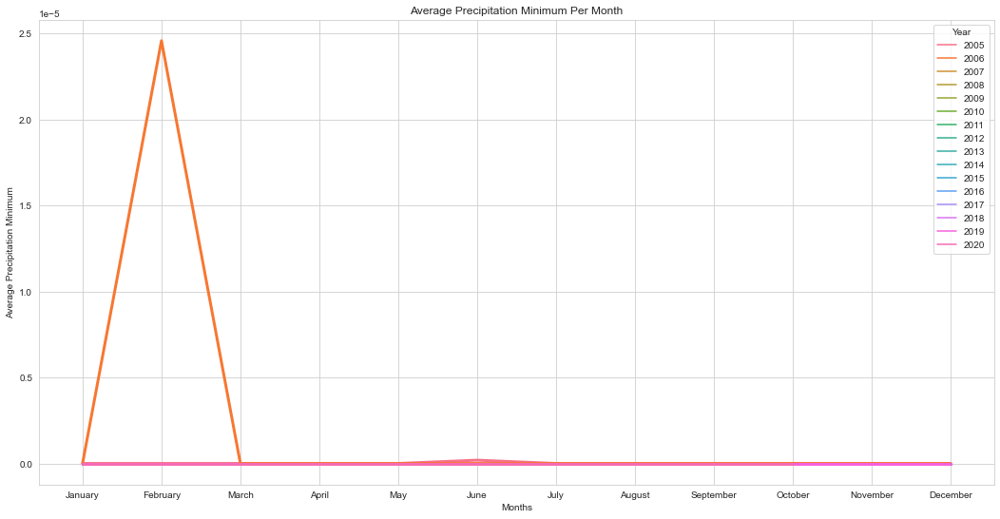

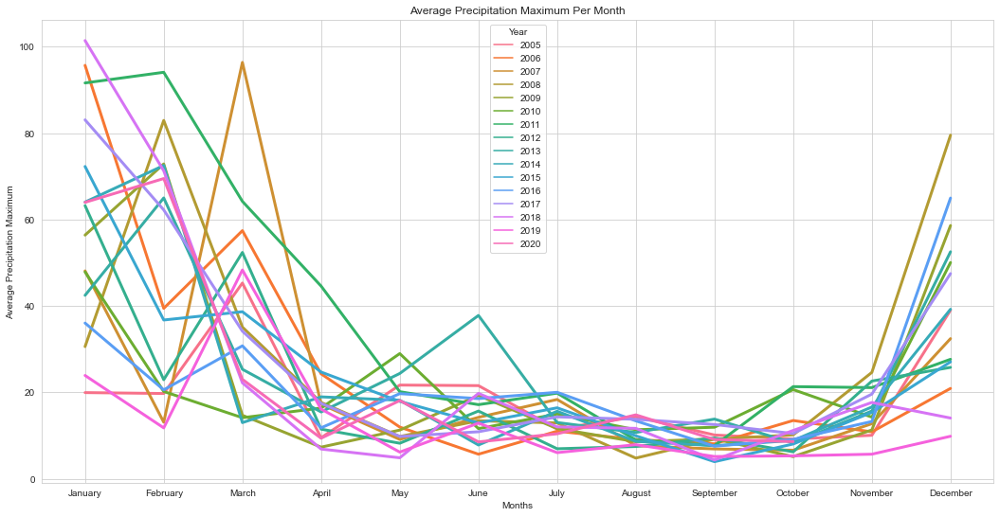

In [50]:
df_precipitation_WA = weather_WA[['Region', 'Date' ,'Precipitation_min', 'Precipitation_max']].copy()
df_precipitation_WA.drop_duplicates(inplace=True)
df_precipitation_WA.sort_values(by=['Region', 'Date'])
df_precipitation_WA.reset_index(drop=True, inplace=True)

df_precipitation_WA['year'] = df_precipitation_WA['Date'].dt.year
df_precipitation_WA['month'] = df_precipitation_WA['Date'].dt.month
df_precipitation_WA['month_name'] = df_precipitation_WA['Date'].dt.strftime('%B')

df_p = df_precipitation_WA.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'Precipitation'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### RELATIVE HUMIDITY Min & Max over Time - Year by Year 
<a class="anchor" id="Humidity"></a>

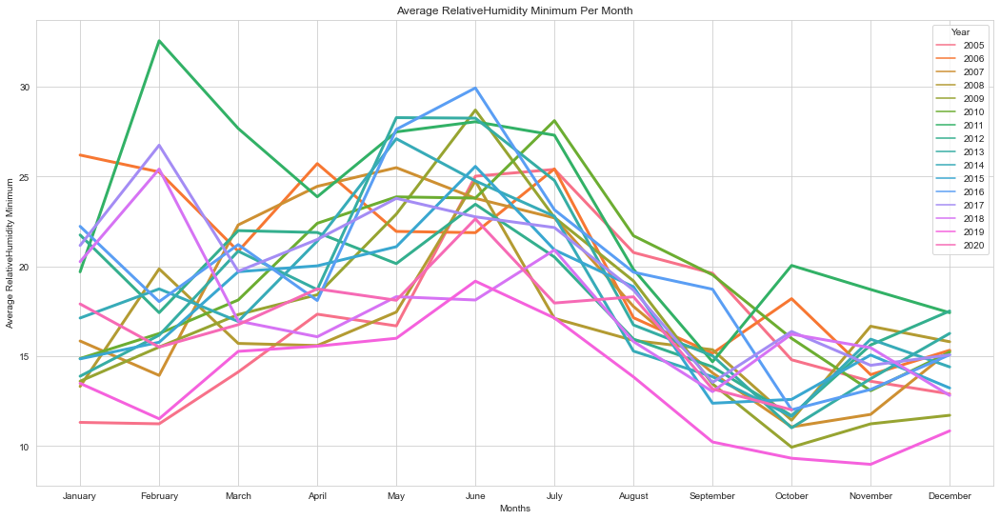

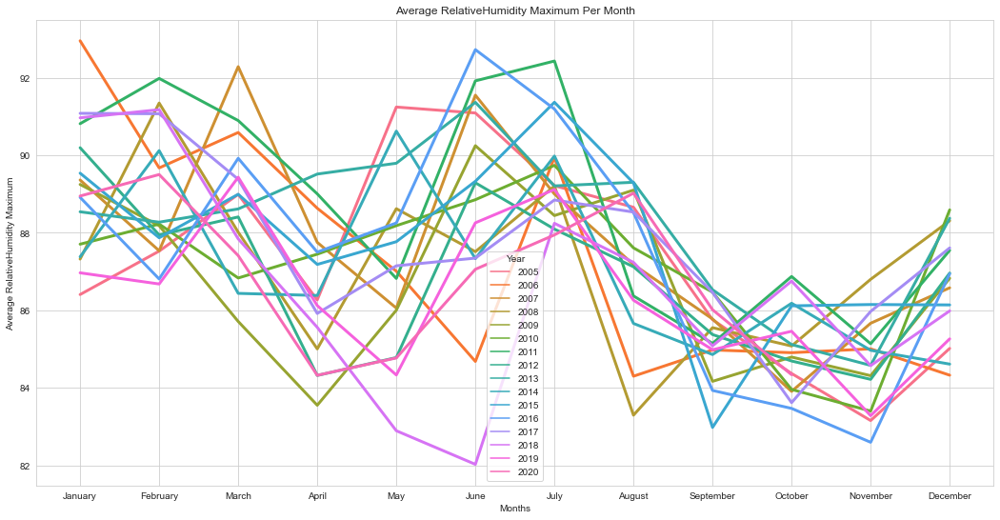

In [51]:
df_humidity_WA = weather_WA[['Region', 'Date' ,'RelativeHumidity_min', 'RelativeHumidity_max']].copy()
df_humidity_WA.drop_duplicates(inplace=True)
df_humidity_WA.sort_values(by=['Region', 'Date'])
df_humidity_WA.reset_index(drop=True, inplace=True)

df_humidity_WA['year'] = df_humidity_WA['Date'].dt.year
df_humidity_WA['month'] = df_humidity_WA['Date'].dt.month
df_humidity_WA['month_name'] = df_humidity_WA['Date'].dt.strftime('%B')

df_p = df_humidity_WA.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'RelativeHumidity'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### SOIL WATER CONTENT Min & Max over Time - Year by Year 
<a class="anchor" id="SoilWater"></a>

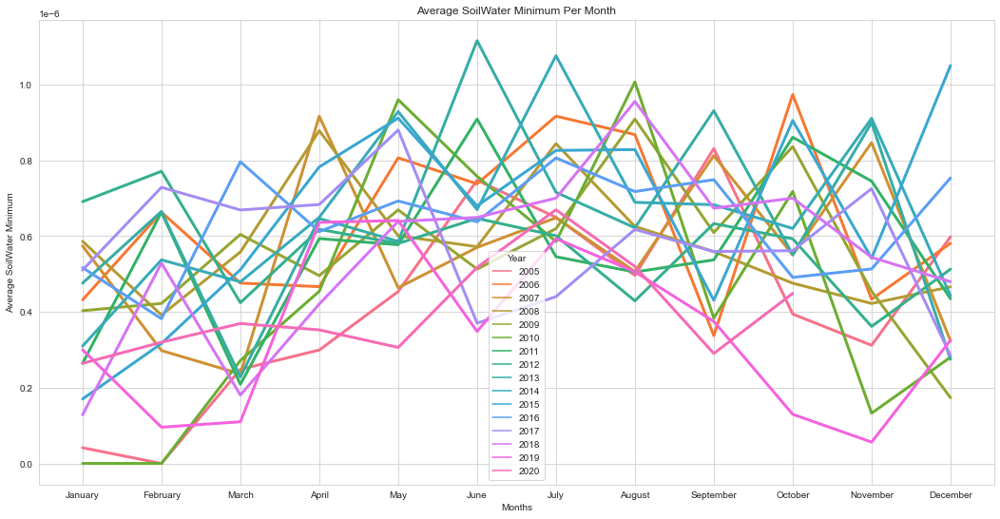

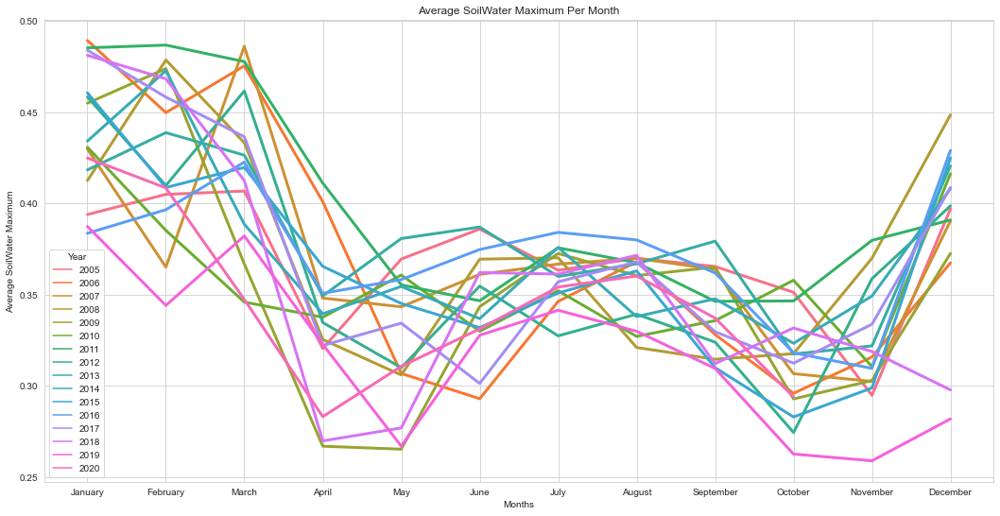

In [52]:
df_soilwater_WA = weather_WA[['Region', 'Date' ,'SoilWaterContent_min', 'SoilWaterContent_max']].copy()
df_soilwater_WA.drop_duplicates(inplace=True)
df_soilwater_WA.sort_values(by=['Region', 'Date'])
df_soilwater_WA.reset_index(drop=True, inplace=True)

df_soilwater_WA['year'] = df_soilwater_WA['Date'].dt.year
df_soilwater_WA['month'] = df_soilwater_WA['Date'].dt.month
df_soilwater_WA['month_name'] = df_soilwater_WA['Date'].dt.strftime('%B')

df_p = df_soilwater_WA.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'SoilWater'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### SOLAR RADIATION Min & Max over Time - Year by Year 
<a class="anchor" id="SolarRadiation"></a>

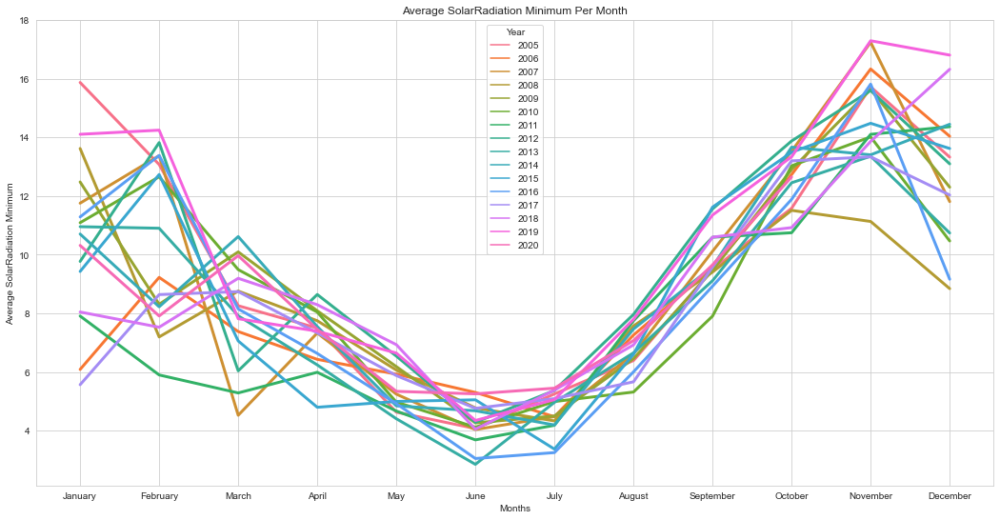

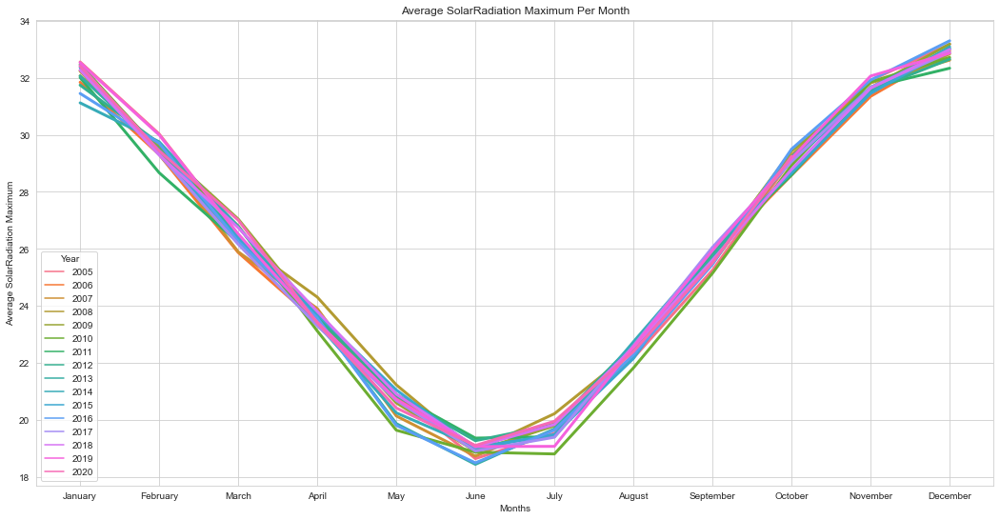

In [53]:
df_solar_radiation_WA = weather_WA[['Region', 'Date' ,'SolarRadiation_min','SolarRadiation_max']].copy()
df_solar_radiation_WA.drop_duplicates(inplace=True)
df_solar_radiation_WA.sort_values(by=['Region', 'Date'])
df_solar_radiation_WA.reset_index(drop=True, inplace=True)

df_solar_radiation_WA['year'] = df_solar_radiation_WA['Date'].dt.year
df_solar_radiation_WA['month'] = df_solar_radiation_WA['Date'].dt.month
df_solar_radiation_WA['month_name'] = df_solar_radiation_WA['Date'].dt.strftime('%B')

df_p = df_solar_radiation_WA.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'SolarRadiation'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### TEMPERATURE Min & Max over Time - Year by Year 
<a class="anchor" id="Temperature"></a>

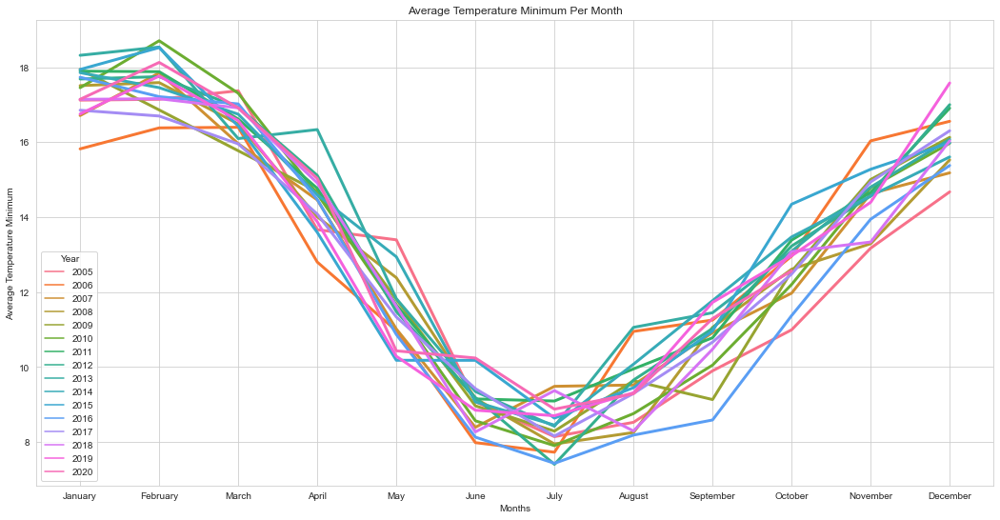

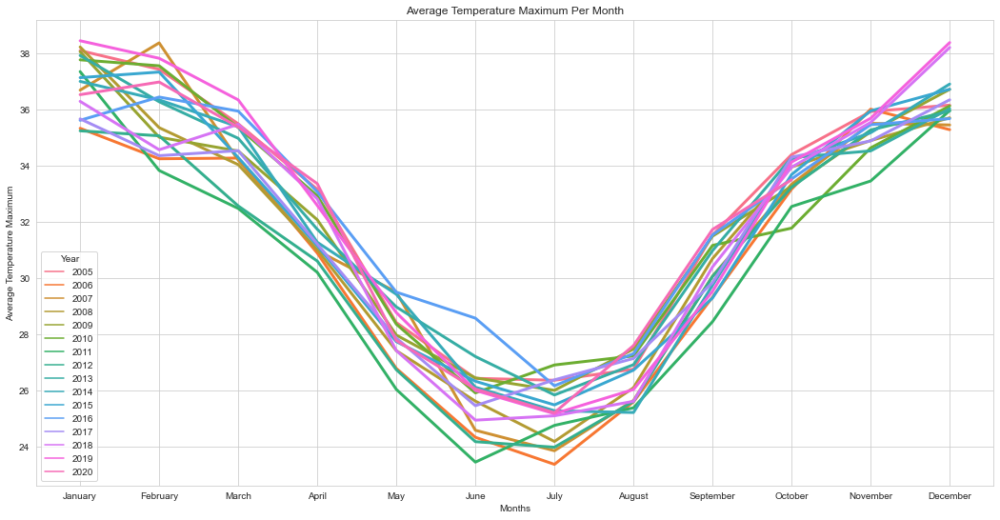

In [54]:
df_temperature_WA = weather_WA[['Region', 'Date' ,'Temperature_min', 'Temperature_max']].copy()
df_temperature_WA.drop_duplicates(inplace=True)
df_temperature_WA.sort_values(by=['Region', 'Date'])
df_temperature_WA.reset_index(drop=True, inplace=True)

df_temperature_WA['year'] = df_temperature_WA['Date'].dt.year
df_temperature_WA['month'] = df_temperature_WA['Date'].dt.month
df_temperature_WA['month_name'] = df_temperature_WA['Date'].dt.strftime('%B')

df_p = df_temperature_WA.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'Temperature'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()

### WINDSPEED Min & Max over Time - Year by Year 
<a class="anchor" id="WindSpeed"></a>

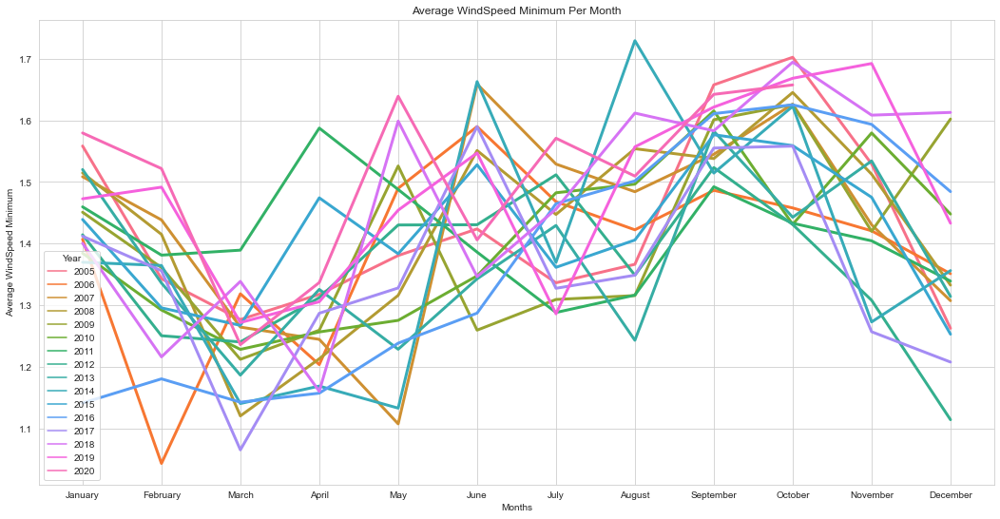

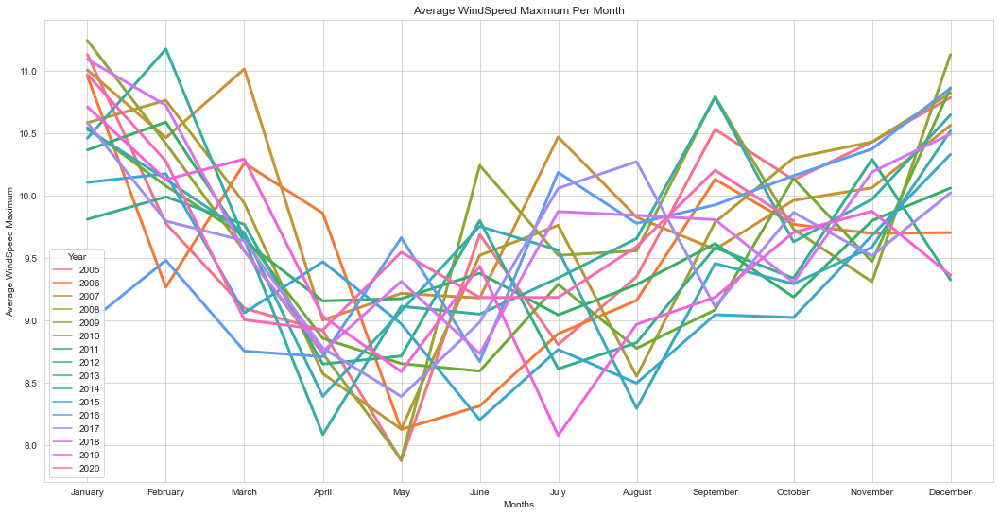

In [56]:
df_windspeed_WA = weather_WA[['Region', 'Date' ,'WindSpeed_min', 'WindSpeed_max']].copy()
df_windspeed_WA.drop_duplicates(inplace=True)
df_windspeed_WA.sort_values(by=['Region', 'Date'])
df_windspeed_WA.reset_index(drop=True, inplace=True)

df_windspeed_WA['year'] = df_windspeed_WA['Date'].dt.year
df_windspeed_WA['month'] = df_windspeed_WA['Date'].dt.month
df_windspeed_WA['month_name'] = df_windspeed_WA['Date'].dt.strftime('%B')

df_p = df_windspeed_WA.groupby(['year', 'month', 'month_name']).mean()
df_p = df_p.reset_index().drop(['month'], axis=1).rename(columns={'month_name': 'month'}).set_index(['year', 'month'])
df_p.reset_index(inplace=True)

param = 'WindSpeed'

num_years = df_p.year.unique().shape[0]
colors = sns.color_palette("husl", num_years)
metric_list = ['Minimum', 'Maximum', 'Mean', 'Variance']

for col_name, metric in zip(df_p.columns[2:], metric_list):
    if col_name.startswith(param):
        lab = '{} {}'.format(param, metric)
        plt.figure(figsize=(18, 9))
        fig = sns.lineplot(x="month", y=col_name, hue="year", data=df_p, linewidth=3, palette=colors)
        fig.set_title('Average {} Per Month'.format(lab))
        fig.set(xlabel='Months', ylabel='Average {}'.format(lab))
        fig.legend().set_title('Year')
        plt.show()